In [1]:
import tensorflow as tf
tf.__version__
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 3097434528366542481,
 name: "/device:XLA_CPU:0"
 device_type: "XLA_CPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 14351541421183652103
 physical_device_desc: "device: XLA_CPU device",
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 6918604064
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 454893406841512080
 physical_device_desc: "device: 0, name: NVIDIA GeForce RTX 2080 SUPER, pci bus id: 0000:01:00.0, compute capability: 7.5",
 name: "/device:XLA_GPU:0"
 device_type: "XLA_GPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 8963302928230189327
 physical_device_desc: "device: XLA_GPU device"]

In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [3]:
tf.debugging.set_log_device_placement(True)

a = tf.constant([[1.0, 2.0, 3.0], [4.0, 5.0, 6.0]])
b = tf.constant([[1.0, 2.0], [3.0, 4.0], [5.0, 6.0]])
c = tf.matmul(a, b)
print(c)

Executing op MatMul in device /job:localhost/replica:0/task:0/device:GPU:0
tf.Tensor(
[[22. 28.]
 [49. 64.]], shape=(2, 2), dtype=float32)


In [4]:
import keras
from keras.models import Sequential, Model
from keras import layers, applications, optimizers
from keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense, Activation, GlobalMaxPooling2D, BatchNormalization, ZeroPadding2D, Input, Add
from keras.preprocessing.image import ImageDataGenerator, load_img

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import random

In [5]:
epoch = 100
batch_size = 5
image_size = 224

In [6]:
#load train data(25000 imgs each)

filenames = os.listdir('./input/train/train')
data = []
categories = []

for filename in filenames:
    category = filename.split('.')[0]
    if category == 'dog':
        categories.append(1)
    else:
        categories.append(0)
    
    image = load_img(os.path.join('./input/train/train', filename), color_mode='rgb', target_size= (image_size,image_size))
    image = np.array(image)
    data.append(image)

data = np.array(data)
categories = np.array(categories)

print(data)
print(categories)

[[[[203 164  87]
   [206 167  90]
   [209 170  93]
   ...
   [245 203 119]
   [241 202 123]
   [239 200 121]]

  [[203 164  87]
   [206 167  90]
   [209 170  93]
   ...
   [245 205 120]
   [242 203 124]
   [240 201 122]]

  [[203 164  87]
   [206 167  90]
   [209 170  93]
   ...
   [245 204 122]
   [243 204 125]
   [241 202 123]]

  ...

  [[154 123  56]
   [155 124  57]
   [156 125  58]
   ...
   [  3   3   1]
   [  3   3   1]
   [  3   3   1]]

  [[153 122  55]
   [153 122  55]
   [154 123  56]
   ...
   [  2   2   0]
   [  2   2   0]
   [  2   2   0]]

  [[151 120  53]
   [152 121  54]
   [153 122  55]
   ...
   [  1   1   0]
   [  1   1   0]
   [  1   1   0]]]


 [[[ 39  44  40]
   [ 40  44  43]
   [ 41  45  46]
   ...
   [210 209 181]
   [207 204 171]
   [201 199 161]]

  [[ 40  45  41]
   [ 40  44  43]
   [ 41  45  46]
   ...
   [207 203 176]
   [203 200 169]
   [197 195 157]]

  [[ 39  44  40]
   [ 38  42  41]
   [ 37  41  42]
   ...
   [195 191 166]
   [198 193 164]
   [205 200

In [7]:
# shuffle dataset

idx = np.random.permutation(len(data))
data, categories = data[idx], categories[idx]

In [8]:
# split train 6(15,000) / val 2(5,000) / test 2(5,000)

x_train = data[:15000]
y_train = categories[:15000]
x_temp, y_temp = data[-10000:], categories[-10000:]

from sklearn.model_selection import train_test_split

x_val, x_test, y_val, y_test = train_test_split(x_temp, y_temp, test_size=0.5)

In [9]:
# data augmentation in train set (train 15,000 to 75,000)

x_train_temp = x_train
y_train_temp = y_train

x_train_aug = []
y_train_aug = []

for img, label in zip(x_train_temp, y_train_temp):
    curImg = img
    
    flipped1 = tf.image.flip_left_right(curImg)
    flipped2 = tf.image.flip_up_down(curImg)
    
    x_train_aug.append(flipped1)
    x_train_aug.append(flipped2)
    
    for i in range(3):
        cropped = curImg[random.randrange(0,100):random.randrange(180,225), random.randrange(0,100):random.randrange(180,225)]
        cropped = cv2.resize(cropped, (image_size, image_size))
        x_train_aug.append(cropped)
    
    for i in range(0, 5):
        y_train_aug.append(label)
        
x_train_aug = np.array(x_train_aug)
y_train_aug = np.array(y_train_aug)

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [10]:
x_train = np.concatenate((x_train, x_train_aug))
y_train = np.concatenate((y_train, y_train_aug))

In [11]:
def build_resnet_block(input_layer, num_cnn=3, channel=64, block_num=1):

    x = input_layer
    
    for cnn_num in range(num_cnn):
        shortcut = x
        x = keras.layers.Conv2D(filters=channel, kernel_size=(3,3), activation='relu', kernel_initializer='he_normal',
            padding='same', name=f'block{block_num}_conv{cnn_num}')(x)
        x = keras.layers.BatchNormalization()(x)
        x = keras.layers.Conv2D( filters=channel, kernel_size=(3,3), activation='relu', kernel_initializer='he_normal',
            padding='same', name=f'block{block_num}_1_conv{cnn_num}')(x)

        shortcut_channel = shortcut.shape.as_list()[-1]
        if shortcut_channel != channel:
            shortcut = Conv2D(channel, kernel_size=(1,1), strides=(1,1), padding='same')(shortcut)  
        # skip connection
        x = keras.layers.Add()([x, shortcut])

    return x

In [12]:
def build_resnet(input_shape=(image_size, image_size, 3),
              num_cnn_list=[3, 4, 6, 3], channel_list=[64, 128, 256, 512], num_classes=2):
        
    input_layer = keras.layers.Input(shape=input_shape)
    
    output = input_layer
    
    output = keras.layers.Conv2D(filters=64, kernel_size=(7,7), strides=2, padding = 'same')(output)
    output = keras.layers.BatchNormalization()(output)
    output = keras.layers.MaxPooling2D(pool_size=(3, 3), strides=2)(output)
    
    for i, (num_cnn, channel) in enumerate(zip(num_cnn_list, channel_list)):
        output = build_resnet_block(output, num_cnn=num_cnn, channel=channel, block_num=i)
        
    output = keras.layers.AveragePooling2D(padding = 'same')(output)
    output = keras.layers.Flatten(name='flatten')(output)
    output = keras.layers.Dense(1000, activation='relu', name='fc1')(output)    
    output = keras.layers.Dense(num_classes, activation='softmax', name='softmax')(output)
    
    model = keras.Model(
        inputs=input_layer,
        outputs=output
    )
    
    return model

In [13]:
# readymade ResNet50

from keras.applications.resnet50 import ResNet50

model = ResNet50()

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in 

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/

In [14]:
# model = build_resnet()

In [15]:
model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.9),
    metrics=['accuracy']
)

Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:lo

In [16]:
model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
___________________________________________________________________________________________

conv4_block5_1_bn (BatchNormali (None, 14, 14, 256)  1024        conv4_block5_1_conv[0][0]        
__________________________________________________________________________________________________
conv4_block5_1_relu (Activation (None, 14, 14, 256)  0           conv4_block5_1_bn[0][0]          
__________________________________________________________________________________________________
conv4_block5_2_conv (Conv2D)    (None, 14, 14, 256)  590080      conv4_block5_1_relu[0][0]        
__________________________________________________________________________________________________
conv4_block5_2_bn (BatchNormali (None, 14, 14, 256)  1024        conv4_block5_2_conv[0][0]        
__________________________________________________________________________________________________
conv4_block5_2_relu (Activation (None, 14, 14, 256)  0           conv4_block5_2_bn[0][0]          
__________________________________________________________________________________________________
conv4_bloc

In [17]:
# %load_ext tensorboard
%reload_ext tensorboard

import datetime

In [18]:
log_dir = "logs/resnet_da_new/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [19]:
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

early_stopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=10)
model_checkpoint = ModelCheckpoint('resnet.h5', monitor='val_loss', mode='min', verbose=1, save_best_only=True)

In [20]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=1)

In [21]:
epoch = 30

history = model.fit(
    x_train, y_train,
    epochs=epoch,
    validation_data=(x_val, y_val),
    verbose=1,
    callbacks=[tensorboard_callback, reduce_lr]
)

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op SummaryWriter 

Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device 

Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:loc

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost

Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:lo

Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device 

Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:loc

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost

Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:lo

Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0
   1/2813 [..............................] - ETA: 0s - loss: 10.0152 - accuracy: 0.0000e+00Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
Executing op FlushSummaryWriter in device /job:localhost/replica:0/tas

  80/2813 [..............................] - ETA: 7:31 - loss: 2.2445 - accuracy: 0.4992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 123/2813 [>.............................] - ETA: 7:23 - loss: 1.8155 - accuracy: 0.4995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 166/2813 [>.............................] - ETA: 7:16 - loss: 1.5568 - accuracy: 0.5030Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 209/2813 [=>............................] - ETA: 7:09 - loss: 1.3981 - accuracy: 0.5055Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 252/2813 [=>............................] - ETA: 7:02 - loss: 1.2769 - accuracy: 0.5148Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 295/2813 [==>...........................] - ETA: 6:55 - loss: 1.1940 - accuracy: 0.5194Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 338/2813 [==>...........................] - ETA: 6:48 - loss: 1.1342 - accuracy: 0.5221Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 381/2813 [===>..........................] - ETA: 6:40 - loss: 1.0836 - accuracy: 0.5274Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 424/2813 [===>..........................] - ETA: 6:33 - loss: 1.0458 - accuracy: 0.5298Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 467/2813 [===>..........................] - ETA: 6:26 - loss: 1.0150 - accuracy: 0.5296Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 510/2813 [====>.........................] - ETA: 6:19 - loss: 0.9871 - accuracy: 0.5328Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 553/2813 [====>.........................] - ETA: 6:12 - loss: 0.9629 - accuracy: 0.5364Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 596/2813 [=====>........................] - ETA: 6:05 - loss: 0.9436 - accuracy: 0.5374Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 639/2813 [=====>........................] - ETA: 5:58 - loss: 0.9259 - accuracy: 0.5408Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 682/2813 [======>.......................] - ETA: 5:51 - loss: 0.9095 - accuracy: 0.5450Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 725/2813 [======>.......................] - ETA: 5:44 - loss: 0.8955 - accuracy: 0.5469Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 768/2813 [=======>......................] - ETA: 5:37 - loss: 0.8822 - accuracy: 0.5501Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 811/2813 [=======>......................] - ETA: 5:30 - loss: 0.8700 - accuracy: 0.5541Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 854/2813 [========>.....................] - ETA: 5:22 - loss: 0.8592 - accuracy: 0.5576Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 897/2813 [========>.....................] - ETA: 5:15 - loss: 0.8507 - accuracy: 0.5588Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 940/2813 [=========>....................] - ETA: 5:08 - loss: 0.8417 - accuracy: 0.5612Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 983/2813 [=========>....................] - ETA: 5:01 - loss: 0.8341 - accuracy: 0.5629Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1026/2813 [=========>....................] - ETA: 4:54 - loss: 0.8274 - accuracy: 0.5645Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1069/2813 [==========>...................] - ETA: 4:47 - loss: 0.8203 - accuracy: 0.5668Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1112/2813 [==========>...................] - ETA: 4:40 - loss: 0.8132 - accuracy: 0.5696Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1155/2813 [===========>..................] - ETA: 4:33 - loss: 0.8076 - accuracy: 0.5707Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1198/2813 [===========>..................] - ETA: 4:26 - loss: 0.8029 - accuracy: 0.5714Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1241/2813 [============>.................] - ETA: 4:19 - loss: 0.7972 - accuracy: 0.5738Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1284/2813 [============>.................] - ETA: 4:12 - loss: 0.7915 - accuracy: 0.5763Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1327/2813 [=============>................] - ETA: 4:05 - loss: 0.7872 - accuracy: 0.5779Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1370/2813 [=============>................] - ETA: 3:57 - loss: 0.7825 - accuracy: 0.5797Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1413/2813 [==============>...............] - ETA: 3:50 - loss: 0.7784 - accuracy: 0.5806Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1456/2813 [==============>...............] - ETA: 3:43 - loss: 0.7739 - accuracy: 0.5827Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1499/2813 [==============>...............] - ETA: 3:36 - loss: 0.7702 - accuracy: 0.5838Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1542/2813 [===============>..............] - ETA: 3:29 - loss: 0.7667 - accuracy: 0.5852Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1585/2813 [===============>..............] - ETA: 3:22 - loss: 0.7633 - accuracy: 0.5865Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1628/2813 [================>.............] - ETA: 3:15 - loss: 0.7600 - accuracy: 0.5878Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1671/2813 [================>.............] - ETA: 3:08 - loss: 0.7572 - accuracy: 0.5888Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1714/2813 [=================>............] - ETA: 3:01 - loss: 0.7538 - accuracy: 0.5902Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1757/2813 [=================>............] - ETA: 2:54 - loss: 0.7507 - accuracy: 0.5916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1800/2813 [==================>...........] - ETA: 2:47 - loss: 0.7479 - accuracy: 0.5930Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1843/2813 [==================>...........] - ETA: 2:40 - loss: 0.7452 - accuracy: 0.5940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1886/2813 [===================>..........] - ETA: 2:32 - loss: 0.7424 - accuracy: 0.5957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1929/2813 [===================>..........] - ETA: 2:25 - loss: 0.7400 - accuracy: 0.5965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1972/2813 [====================>.........] - ETA: 2:18 - loss: 0.7381 - accuracy: 0.5975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2015/2813 [====================>.........] - ETA: 2:11 - loss: 0.7353 - accuracy: 0.5989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2058/2813 [====================>.........] - ETA: 2:04 - loss: 0.7324 - accuracy: 0.6003Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2101/2813 [=====================>........] - ETA: 1:57 - loss: 0.7303 - accuracy: 0.6012Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2144/2813 [=====================>........] - ETA: 1:50 - loss: 0.7285 - accuracy: 0.6017Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2187/2813 [======================>.......] - ETA: 1:43 - loss: 0.7267 - accuracy: 0.6024Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2230/2813 [======================>.......] - ETA: 1:36 - loss: 0.7242 - accuracy: 0.6037Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2273/2813 [=======================>......] - ETA: 1:29 - loss: 0.7221 - accuracy: 0.6049Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2316/2813 [=======================>......] - ETA: 1:22 - loss: 0.7198 - accuracy: 0.6061Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2359/2813 [========================>.....] - ETA: 1:14 - loss: 0.7177 - accuracy: 0.6075Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2402/2813 [========================>.....] - ETA: 1:07 - loss: 0.7160 - accuracy: 0.6084Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2445/2813 [=========================>....] - ETA: 1:00 - loss: 0.7141 - accuracy: 0.6094Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2488/2813 [=========================>....] - ETA: 53s - loss: 0.7122 - accuracy: 0.6103Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2531/2813 [=========================>....] - ETA: 46s - loss: 0.7107 - accuracy: 0.6110Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2574/2813 [==========================>...] - ETA: 39s - loss: 0.7094 - accuracy: 0.6119Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2617/2813 [==========================>...] - ETA: 32s - loss: 0.7082 - accuracy: 0.6128Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2660/2813 [===========================>..] - ETA: 25s - loss: 0.7067 - accuracy: 0.6135Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2703/2813 [===========================>..] - ETA: 18s - loss: 0.7049 - accuracy: 0.6144Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2746/2813 [============================>.] - ETA: 11s - loss: 0.7031 - accuracy: 0.6156Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2790/2813 [============================>.] - ETA: 3s - loss: 0.7014 - accuracy: 0.6165Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.7011 - accuracy: 0.6163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

  54/2813 [..............................] - ETA: 7:26 - loss: 0.5996 - accuracy: 0.6765Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  97/2813 [>.............................] - ETA: 7:23 - loss: 0.5987 - accuracy: 0.6811Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 140/2813 [>.............................] - ETA: 7:17 - loss: 0.5972 - accuracy: 0.6830Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 183/2813 [>.............................] - ETA: 7:11 - loss: 0.5953 - accuracy: 0.6827Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 226/2813 [=>............................] - ETA: 7:05 - loss: 0.5955 - accuracy: 0.6840Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 269/2813 [=>............................] - ETA: 6:58 - loss: 0.5914 - accuracy: 0.6878Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 312/2813 [==>...........................] - ETA: 6:51 - loss: 0.5893 - accuracy: 0.6880Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 355/2813 [==>...........................] - ETA: 6:44 - loss: 0.5904 - accuracy: 0.6863Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 398/2813 [===>..........................] - ETA: 6:37 - loss: 0.5873 - accuracy: 0.6884Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 441/2813 [===>..........................] - ETA: 6:30 - loss: 0.5879 - accuracy: 0.6894Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 484/2813 [====>.........................] - ETA: 6:23 - loss: 0.5842 - accuracy: 0.6935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 527/2813 [====>.........................] - ETA: 6:16 - loss: 0.5827 - accuracy: 0.6957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 570/2813 [=====>........................] - ETA: 6:09 - loss: 0.5814 - accuracy: 0.6963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 613/2813 [=====>........................] - ETA: 6:02 - loss: 0.5806 - accuracy: 0.6966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 656/2813 [=====>........................] - ETA: 5:55 - loss: 0.5798 - accuracy: 0.6972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 699/2813 [======>.......................] - ETA: 5:48 - loss: 0.5799 - accuracy: 0.6962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 742/2813 [======>.......................] - ETA: 5:41 - loss: 0.5781 - accuracy: 0.6979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 785/2813 [=======>......................] - ETA: 5:34 - loss: 0.5773 - accuracy: 0.6984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 828/2813 [=======>......................] - ETA: 5:27 - loss: 0.5762 - accuracy: 0.6990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 871/2813 [========>.....................] - ETA: 5:20 - loss: 0.5747 - accuracy: 0.7006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 914/2813 [========>.....................] - ETA: 5:13 - loss: 0.5733 - accuracy: 0.7021Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 957/2813 [=========>....................] - ETA: 5:06 - loss: 0.5728 - accuracy: 0.7021Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1000/2813 [=========>....................] - ETA: 4:59 - loss: 0.5714 - accuracy: 0.7030Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1043/2813 [==========>...................] - ETA: 4:52 - loss: 0.5695 - accuracy: 0.7046Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1086/2813 [==========>...................] - ETA: 4:44 - loss: 0.5680 - accuracy: 0.7061Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1129/2813 [===========>..................] - ETA: 4:37 - loss: 0.5674 - accuracy: 0.7065Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1172/2813 [===========>..................] - ETA: 4:30 - loss: 0.5657 - accuracy: 0.7076Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1215/2813 [===========>..................] - ETA: 4:23 - loss: 0.5653 - accuracy: 0.7079Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1258/2813 [============>.................] - ETA: 4:16 - loss: 0.5653 - accuracy: 0.7081Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1301/2813 [============>.................] - ETA: 4:09 - loss: 0.5644 - accuracy: 0.7088Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1344/2813 [=============>................] - ETA: 4:02 - loss: 0.5640 - accuracy: 0.7095Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1387/2813 [=============>................] - ETA: 3:55 - loss: 0.5632 - accuracy: 0.7101Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1430/2813 [==============>...............] - ETA: 3:48 - loss: 0.5626 - accuracy: 0.7101Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1473/2813 [==============>...............] - ETA: 3:41 - loss: 0.5621 - accuracy: 0.7105Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1516/2813 [===============>..............] - ETA: 3:34 - loss: 0.5613 - accuracy: 0.7112Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1559/2813 [===============>..............] - ETA: 3:26 - loss: 0.5614 - accuracy: 0.7110Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1602/2813 [================>.............] - ETA: 3:19 - loss: 0.5611 - accuracy: 0.7109Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1645/2813 [================>.............] - ETA: 3:12 - loss: 0.5603 - accuracy: 0.7113Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1688/2813 [=================>............] - ETA: 3:05 - loss: 0.5597 - accuracy: 0.7118Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1731/2813 [=================>............] - ETA: 2:58 - loss: 0.5595 - accuracy: 0.7123Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1774/2813 [=================>............] - ETA: 2:51 - loss: 0.5589 - accuracy: 0.7124Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1817/2813 [==================>...........] - ETA: 2:44 - loss: 0.5585 - accuracy: 0.7127Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1860/2813 [==================>...........] - ETA: 2:37 - loss: 0.5580 - accuracy: 0.7129Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1903/2813 [===================>..........] - ETA: 2:30 - loss: 0.5578 - accuracy: 0.7129Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1946/2813 [===================>..........] - ETA: 2:23 - loss: 0.5571 - accuracy: 0.7133Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1989/2813 [====================>.........] - ETA: 2:15 - loss: 0.5572 - accuracy: 0.7131Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2032/2813 [====================>.........] - ETA: 2:08 - loss: 0.5574 - accuracy: 0.7130Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2075/2813 [=====================>........] - ETA: 2:01 - loss: 0.5565 - accuracy: 0.7136Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2118/2813 [=====================>........] - ETA: 1:54 - loss: 0.5561 - accuracy: 0.7141Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2161/2813 [======================>.......] - ETA: 1:47 - loss: 0.5552 - accuracy: 0.7147Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2204/2813 [======================>.......] - ETA: 1:40 - loss: 0.5546 - accuracy: 0.7149Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2247/2813 [======================>.......] - ETA: 1:33 - loss: 0.5543 - accuracy: 0.7151Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2290/2813 [=======================>......] - ETA: 1:26 - loss: 0.5536 - accuracy: 0.7155Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2333/2813 [=======================>......] - ETA: 1:19 - loss: 0.5527 - accuracy: 0.7164Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2376/2813 [========================>.....] - ETA: 1:12 - loss: 0.5527 - accuracy: 0.7163Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2419/2813 [========================>.....] - ETA: 1:05 - loss: 0.5520 - accuracy: 0.7169Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2462/2813 [=========================>....] - ETA: 57s - loss: 0.5518 - accuracy: 0.7170Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2505/2813 [=========================>....] - ETA: 50s - loss: 0.5514 - accuracy: 0.7173Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2548/2813 [==========================>...] - ETA: 43s - loss: 0.5504 - accuracy: 0.7181Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2591/2813 [==========================>...] - ETA: 36s - loss: 0.5502 - accuracy: 0.7184Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2634/2813 [===========================>..] - ETA: 29s - loss: 0.5499 - accuracy: 0.7186Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2677/2813 [===========================>..] - ETA: 22s - loss: 0.5495 - accuracy: 0.7188Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2720/2813 [============================>.] - ETA: 15s - loss: 0.5491 - accuracy: 0.7193Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2763/2813 [============================>.] - ETA: 8s - loss: 0.5487 - accuracy: 0.7195Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2807/2813 [============================>.] - ETA: 0s - loss: 0.5483 - accuracy: 0.7197Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.5482 - accuracy: 0.7196Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 474s 168ms/step - loss: 0.5482 - accuracy:

  78/2813 [..............................] - ETA: 7:25 - loss: 0.5032 - accuracy: 0.7512Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 121/2813 [>.............................] - ETA: 7:20 - loss: 0.5078 - accuracy: 0.7487Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 164/2813 [>.............................] - ETA: 7:14 - loss: 0.5094 - accuracy: 0.7468Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 207/2813 [=>............................] - ETA: 7:08 - loss: 0.5063 - accuracy: 0.7483Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 250/2813 [=>............................] - ETA: 7:01 - loss: 0.5051 - accuracy: 0.7485Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 293/2813 [==>...........................] - ETA: 6:54 - loss: 0.5047 - accuracy: 0.7496Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 336/2813 [==>...........................] - ETA: 6:47 - loss: 0.5071 - accuracy: 0.7477Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 379/2813 [===>..........................] - ETA: 6:40 - loss: 0.5085 - accuracy: 0.7465Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 422/2813 [===>..........................] - ETA: 6:33 - loss: 0.5087 - accuracy: 0.7467Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 465/2813 [===>..........................] - ETA: 6:26 - loss: 0.5074 - accuracy: 0.7485Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 508/2813 [====>.........................] - ETA: 6:19 - loss: 0.5092 - accuracy: 0.7474Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 551/2813 [====>.........................] - ETA: 6:12 - loss: 0.5107 - accuracy: 0.7471Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 594/2813 [=====>........................] - ETA: 6:06 - loss: 0.5089 - accuracy: 0.7477Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 637/2813 [=====>........................] - ETA: 5:59 - loss: 0.5108 - accuracy: 0.7464Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 680/2813 [======>.......................] - ETA: 5:52 - loss: 0.5087 - accuracy: 0.7473Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 723/2813 [======>.......................] - ETA: 5:45 - loss: 0.5102 - accuracy: 0.7460Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 766/2813 [=======>......................] - ETA: 5:38 - loss: 0.5088 - accuracy: 0.7461Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 809/2813 [=======>......................] - ETA: 5:31 - loss: 0.5076 - accuracy: 0.7469Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 852/2813 [========>.....................] - ETA: 5:24 - loss: 0.5089 - accuracy: 0.7459Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 895/2813 [========>.....................] - ETA: 5:16 - loss: 0.5100 - accuracy: 0.7456Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 938/2813 [=========>....................] - ETA: 5:09 - loss: 0.5088 - accuracy: 0.7461Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 981/2813 [=========>....................] - ETA: 5:02 - loss: 0.5081 - accuracy: 0.7467Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1024/2813 [=========>....................] - ETA: 4:55 - loss: 0.5074 - accuracy: 0.7472Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1067/2813 [==========>...................] - ETA: 4:48 - loss: 0.5073 - accuracy: 0.7476Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1110/2813 [==========>...................] - ETA: 4:41 - loss: 0.5075 - accuracy: 0.7478Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1153/2813 [===========>..................] - ETA: 4:34 - loss: 0.5075 - accuracy: 0.7478Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1196/2813 [===========>..................] - ETA: 4:27 - loss: 0.5072 - accuracy: 0.7481Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1239/2813 [============>.................] - ETA: 4:19 - loss: 0.5068 - accuracy: 0.7483Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1282/2813 [============>.................] - ETA: 4:12 - loss: 0.5053 - accuracy: 0.7489Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1325/2813 [=============>................] - ETA: 4:05 - loss: 0.5051 - accuracy: 0.7489Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1368/2813 [=============>................] - ETA: 3:58 - loss: 0.5056 - accuracy: 0.7492Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1411/2813 [==============>...............] - ETA: 3:51 - loss: 0.5051 - accuracy: 0.7498Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1454/2813 [==============>...............] - ETA: 3:44 - loss: 0.5052 - accuracy: 0.7499Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1497/2813 [==============>...............] - ETA: 3:37 - loss: 0.5049 - accuracy: 0.7501Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1540/2813 [===============>..............] - ETA: 3:30 - loss: 0.5043 - accuracy: 0.7504Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1583/2813 [===============>..............] - ETA: 3:23 - loss: 0.5037 - accuracy: 0.7510Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1626/2813 [================>.............] - ETA: 3:16 - loss: 0.5030 - accuracy: 0.7513Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1669/2813 [================>.............] - ETA: 3:08 - loss: 0.5025 - accuracy: 0.7515Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1712/2813 [=================>............] - ETA: 3:01 - loss: 0.5024 - accuracy: 0.7518Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1755/2813 [=================>............] - ETA: 2:54 - loss: 0.5029 - accuracy: 0.7515Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1798/2813 [==================>...........] - ETA: 2:47 - loss: 0.5024 - accuracy: 0.7517Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1841/2813 [==================>...........] - ETA: 2:40 - loss: 0.5021 - accuracy: 0.7522Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1884/2813 [===================>..........] - ETA: 2:33 - loss: 0.5015 - accuracy: 0.7527Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1927/2813 [===================>..........] - ETA: 2:26 - loss: 0.5012 - accuracy: 0.7530Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1970/2813 [====================>.........] - ETA: 2:19 - loss: 0.5001 - accuracy: 0.7536Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2013/2813 [====================>.........] - ETA: 2:12 - loss: 0.5001 - accuracy: 0.7538Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2056/2813 [====================>.........] - ETA: 2:05 - loss: 0.4997 - accuracy: 0.7542Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2099/2813 [=====================>........] - ETA: 1:57 - loss: 0.4994 - accuracy: 0.7544Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2142/2813 [=====================>........] - ETA: 1:50 - loss: 0.4988 - accuracy: 0.7547Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2185/2813 [======================>.......] - ETA: 1:43 - loss: 0.4981 - accuracy: 0.7553Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2228/2813 [======================>.......] - ETA: 1:36 - loss: 0.4974 - accuracy: 0.7559Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2271/2813 [=======================>......] - ETA: 1:29 - loss: 0.4973 - accuracy: 0.7561Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2314/2813 [=======================>......] - ETA: 1:22 - loss: 0.4968 - accuracy: 0.7565Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2357/2813 [========================>.....] - ETA: 1:15 - loss: 0.4966 - accuracy: 0.7567Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2400/2813 [========================>.....] - ETA: 1:08 - loss: 0.4964 - accuracy: 0.7568Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2443/2813 [=========================>....] - ETA: 1:01 - loss: 0.4963 - accuracy: 0.7567Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2486/2813 [=========================>....] - ETA: 54s - loss: 0.4953 - accuracy: 0.7572Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2529/2813 [=========================>....] - ETA: 46s - loss: 0.4948 - accuracy: 0.7574Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2572/2813 [==========================>...] - ETA: 39s - loss: 0.4945 - accuracy: 0.7574Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2615/2813 [==========================>...] - ETA: 32s - loss: 0.4940 - accuracy: 0.7579Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2658/2813 [===========================>..] - ETA: 25s - loss: 0.4939 - accuracy: 0.7580Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2701/2813 [===========================>..] - ETA: 18s - loss: 0.4935 - accuracy: 0.7581Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2744/2813 [============================>.] - ETA: 11s - loss: 0.4932 - accuracy: 0.7585Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2788/2813 [============================>.] - ETA: 4s - loss: 0.4926 - accuracy: 0.7589Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.4920 - accuracy: 0.7593Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  59/2813 [..............................] - ETA: 7:27 - loss: 0.4576 - accuracy: 0.7865Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 102/2813 [>.............................] - ETA: 7:23 - loss: 0.4590 - accuracy: 0.7791Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 145/2813 [>.............................] - ETA: 7:18 - loss: 0.4609 - accuracy: 0.7823Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 188/2813 [=>............................] - ETA: 7:11 - loss: 0.4595 - accuracy: 0.7844Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 231/2813 [=>............................] - ETA: 7:05 - loss: 0.4596 - accuracy: 0.7850Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 274/2813 [=>............................] - ETA: 6:58 - loss: 0.4589 - accuracy: 0.7826Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 317/2813 [==>...........................] - ETA: 6:51 - loss: 0.4580 - accuracy: 0.7827Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 360/2813 [==>...........................] - ETA: 6:44 - loss: 0.4540 - accuracy: 0.7852Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 403/2813 [===>..........................] - ETA: 6:37 - loss: 0.4532 - accuracy: 0.7864Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 446/2813 [===>..........................] - ETA: 6:30 - loss: 0.4543 - accuracy: 0.7857Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 489/2813 [====>.........................] - ETA: 6:23 - loss: 0.4543 - accuracy: 0.7855Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 532/2813 [====>.........................] - ETA: 6:16 - loss: 0.4568 - accuracy: 0.7854Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 575/2813 [=====>........................] - ETA: 6:09 - loss: 0.4572 - accuracy: 0.7854Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 618/2813 [=====>........................] - ETA: 6:02 - loss: 0.4570 - accuracy: 0.7852Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 661/2813 [======>.......................] - ETA: 5:55 - loss: 0.4568 - accuracy: 0.7850Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 704/2813 [======>.......................] - ETA: 5:48 - loss: 0.4573 - accuracy: 0.7845Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 747/2813 [======>.......................] - ETA: 5:41 - loss: 0.4568 - accuracy: 0.7853Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 790/2813 [=======>......................] - ETA: 5:34 - loss: 0.4552 - accuracy: 0.7859Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 833/2813 [=======>......................] - ETA: 5:26 - loss: 0.4554 - accuracy: 0.7861Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 876/2813 [========>.....................] - ETA: 5:19 - loss: 0.4538 - accuracy: 0.7861Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 919/2813 [========>.....................] - ETA: 5:12 - loss: 0.4538 - accuracy: 0.7858Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 962/2813 [=========>....................] - ETA: 5:05 - loss: 0.4533 - accuracy: 0.7857Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1005/2813 [=========>....................] - ETA: 4:58 - loss: 0.4530 - accuracy: 0.7860Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1048/2813 [==========>...................] - ETA: 4:51 - loss: 0.4522 - accuracy: 0.7862Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1091/2813 [==========>...................] - ETA: 4:44 - loss: 0.4523 - accuracy: 0.7863Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1134/2813 [===========>..................] - ETA: 4:37 - loss: 0.4526 - accuracy: 0.7857Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1177/2813 [===========>..................] - ETA: 4:30 - loss: 0.4524 - accuracy: 0.7860Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1220/2813 [============>.................] - ETA: 4:23 - loss: 0.4522 - accuracy: 0.7862Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1263/2813 [============>.................] - ETA: 4:16 - loss: 0.4515 - accuracy: 0.7865Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1306/2813 [============>.................] - ETA: 4:08 - loss: 0.4506 - accuracy: 0.7871Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1349/2813 [=============>................] - ETA: 4:01 - loss: 0.4504 - accuracy: 0.7872Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1392/2813 [=============>................] - ETA: 3:54 - loss: 0.4500 - accuracy: 0.7873Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1435/2813 [==============>...............] - ETA: 3:47 - loss: 0.4488 - accuracy: 0.7882Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1478/2813 [==============>...............] - ETA: 3:40 - loss: 0.4478 - accuracy: 0.7886Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1521/2813 [===============>..............] - ETA: 3:33 - loss: 0.4473 - accuracy: 0.7889Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1564/2813 [===============>..............] - ETA: 3:26 - loss: 0.4475 - accuracy: 0.7888Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1607/2813 [================>.............] - ETA: 3:19 - loss: 0.4475 - accuracy: 0.7888Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1650/2813 [================>.............] - ETA: 3:12 - loss: 0.4473 - accuracy: 0.7889Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1693/2813 [=================>............] - ETA: 3:04 - loss: 0.4467 - accuracy: 0.7895Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1736/2813 [=================>............] - ETA: 2:57 - loss: 0.4464 - accuracy: 0.7896Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1779/2813 [=================>............] - ETA: 2:50 - loss: 0.4457 - accuracy: 0.7900Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1822/2813 [==================>...........] - ETA: 2:43 - loss: 0.4459 - accuracy: 0.7898Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1865/2813 [==================>...........] - ETA: 2:36 - loss: 0.4450 - accuracy: 0.7900Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1908/2813 [===================>..........] - ETA: 2:29 - loss: 0.4448 - accuracy: 0.7904Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1951/2813 [===================>..........] - ETA: 2:22 - loss: 0.4448 - accuracy: 0.7903Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1994/2813 [====================>.........] - ETA: 2:15 - loss: 0.4441 - accuracy: 0.7905Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2037/2813 [====================>.........] - ETA: 2:08 - loss: 0.4436 - accuracy: 0.7908Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2080/2813 [=====================>........] - ETA: 2:01 - loss: 0.4435 - accuracy: 0.7907Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2123/2813 [=====================>........] - ETA: 1:53 - loss: 0.4432 - accuracy: 0.7910Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2166/2813 [======================>.......] - ETA: 1:46 - loss: 0.4428 - accuracy: 0.7912Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2209/2813 [======================>.......] - ETA: 1:39 - loss: 0.4429 - accuracy: 0.7909Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2252/2813 [=======================>......] - ETA: 1:32 - loss: 0.4425 - accuracy: 0.7911Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2295/2813 [=======================>......] - ETA: 1:25 - loss: 0.4420 - accuracy: 0.7916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2338/2813 [=======================>......] - ETA: 1:18 - loss: 0.4424 - accuracy: 0.7914Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2381/2813 [========================>.....] - ETA: 1:11 - loss: 0.4420 - accuracy: 0.7915Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2424/2813 [========================>.....] - ETA: 1:04 - loss: 0.4412 - accuracy: 0.7920Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2467/2813 [=========================>....] - ETA: 57s - loss: 0.4416 - accuracy: 0.7918Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2510/2813 [=========================>....] - ETA: 50s - loss: 0.4412 - accuracy: 0.7919Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2553/2813 [==========================>...] - ETA: 42s - loss: 0.4413 - accuracy: 0.7918Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2596/2813 [==========================>...] - ETA: 35s - loss: 0.4411 - accuracy: 0.7919Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2639/2813 [===========================>..] - ETA: 28s - loss: 0.4405 - accuracy: 0.7923Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2682/2813 [===========================>..] - ETA: 21s - loss: 0.4406 - accuracy: 0.7923Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2725/2813 [============================>.] - ETA: 14s - loss: 0.4402 - accuracy: 0.7924Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2768/2813 [============================>.] - ETA: 7s - loss: 0.4403 - accuracy: 0.7923Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.4395 - accuracy: 0.7926Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.4395 - accuracy: 0.7926Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0


Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

2813/2813 [==============================] - 474s 168ms/step - loss: 0.4395 - accuracy: 0.7926 - val_loss: 0.3825 - val_accuracy: 0.8336
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Epoch 5/30
Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0
  40/2813 [..............................] - ETA: 7:26 - loss: 0.4341 - accuracy: 0.7969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  83/2813 [..............................] - ETA: 7:25 - loss: 0.4179 - accuracy: 0.8001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 126/2813 [>.............................] - ETA: 7:19 - loss: 0.4083 - accuracy: 0.8058Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 169/2813 [>.............................] - ETA: 7:13 - loss: 0.4105 - accuracy: 0.8062Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 212/2813 [=>............................] - ETA: 7:07 - loss: 0.4093 - accuracy: 0.8090Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 255/2813 [=>............................] - ETA: 7:00 - loss: 0.4139 - accuracy: 0.8058Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 298/2813 [==>...........................] - ETA: 6:54 - loss: 0.4149 - accuracy: 0.8033Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 341/2813 [==>...........................] - ETA: 6:47 - loss: 0.4125 - accuracy: 0.8054Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 384/2813 [===>..........................] - ETA: 6:40 - loss: 0.4117 - accuracy: 0.8072Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 427/2813 [===>..........................] - ETA: 6:33 - loss: 0.4100 - accuracy: 0.8078Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 470/2813 [====>.........................] - ETA: 6:26 - loss: 0.4061 - accuracy: 0.8098Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 513/2813 [====>.........................] - ETA: 6:19 - loss: 0.4067 - accuracy: 0.8099Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 556/2813 [====>.........................] - ETA: 6:12 - loss: 0.4054 - accuracy: 0.8110Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 599/2813 [=====>........................] - ETA: 6:05 - loss: 0.4053 - accuracy: 0.8114Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 642/2813 [=====>........................] - ETA: 5:58 - loss: 0.4061 - accuracy: 0.8110Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 685/2813 [======>.......................] - ETA: 5:51 - loss: 0.4042 - accuracy: 0.8118Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 728/2813 [======>.......................] - ETA: 5:44 - loss: 0.4038 - accuracy: 0.8129Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 771/2813 [=======>......................] - ETA: 5:36 - loss: 0.4057 - accuracy: 0.8115Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 814/2813 [=======>......................] - ETA: 5:29 - loss: 0.4057 - accuracy: 0.8118Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 857/2813 [========>.....................] - ETA: 5:22 - loss: 0.4061 - accuracy: 0.8116Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 900/2813 [========>.....................] - ETA: 5:15 - loss: 0.4072 - accuracy: 0.8110Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 943/2813 [=========>....................] - ETA: 5:08 - loss: 0.4059 - accuracy: 0.8117Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 986/2813 [=========>....................] - ETA: 5:01 - loss: 0.4056 - accuracy: 0.8122Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1029/2813 [=========>....................] - ETA: 4:54 - loss: 0.4045 - accuracy: 0.8128Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1072/2813 [==========>...................] - ETA: 4:47 - loss: 0.4033 - accuracy: 0.8133Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1115/2813 [==========>...................] - ETA: 4:40 - loss: 0.4032 - accuracy: 0.8132Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1158/2813 [===========>..................] - ETA: 4:33 - loss: 0.4027 - accuracy: 0.8134Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1201/2813 [===========>..................] - ETA: 4:26 - loss: 0.4018 - accuracy: 0.8142Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1244/2813 [============>.................] - ETA: 4:19 - loss: 0.4016 - accuracy: 0.8144Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1287/2813 [============>.................] - ETA: 4:12 - loss: 0.4024 - accuracy: 0.8141Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1330/2813 [=============>................] - ETA: 4:05 - loss: 0.4026 - accuracy: 0.8140Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1373/2813 [=============>................] - ETA: 3:58 - loss: 0.4024 - accuracy: 0.8138Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1416/2813 [==============>...............] - ETA: 3:50 - loss: 0.4016 - accuracy: 0.8140Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1459/2813 [==============>...............] - ETA: 3:43 - loss: 0.4014 - accuracy: 0.8138Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1502/2813 [===============>..............] - ETA: 3:36 - loss: 0.4005 - accuracy: 0.8141Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1545/2813 [===============>..............] - ETA: 3:29 - loss: 0.3997 - accuracy: 0.8145Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1588/2813 [===============>..............] - ETA: 3:22 - loss: 0.3992 - accuracy: 0.8149Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1631/2813 [================>.............] - ETA: 3:15 - loss: 0.3984 - accuracy: 0.8154Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1674/2813 [================>.............] - ETA: 3:08 - loss: 0.3975 - accuracy: 0.8161Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1717/2813 [=================>............] - ETA: 3:01 - loss: 0.3965 - accuracy: 0.8166Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1760/2813 [=================>............] - ETA: 2:54 - loss: 0.3964 - accuracy: 0.8170Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1803/2813 [==================>...........] - ETA: 2:46 - loss: 0.3957 - accuracy: 0.8172Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1846/2813 [==================>...........] - ETA: 2:39 - loss: 0.3954 - accuracy: 0.8174Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1889/2813 [===================>..........] - ETA: 2:32 - loss: 0.3952 - accuracy: 0.8175Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1932/2813 [===================>..........] - ETA: 2:25 - loss: 0.3944 - accuracy: 0.8181Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1975/2813 [====================>.........] - ETA: 2:18 - loss: 0.3942 - accuracy: 0.8182Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2018/2813 [====================>.........] - ETA: 2:11 - loss: 0.3928 - accuracy: 0.8188Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2061/2813 [====================>.........] - ETA: 2:04 - loss: 0.3927 - accuracy: 0.8189Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2104/2813 [=====================>........] - ETA: 1:57 - loss: 0.3922 - accuracy: 0.8193Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2147/2813 [=====================>........] - ETA: 1:50 - loss: 0.3916 - accuracy: 0.8196Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2190/2813 [======================>.......] - ETA: 1:42 - loss: 0.3912 - accuracy: 0.8198Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2233/2813 [======================>.......] - ETA: 1:35 - loss: 0.3912 - accuracy: 0.8198Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2276/2813 [=======================>......] - ETA: 1:28 - loss: 0.3906 - accuracy: 0.8200Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2319/2813 [=======================>......] - ETA: 1:21 - loss: 0.3903 - accuracy: 0.8201Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2362/2813 [========================>.....] - ETA: 1:14 - loss: 0.3896 - accuracy: 0.8205Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2405/2813 [========================>.....] - ETA: 1:07 - loss: 0.3891 - accuracy: 0.8207Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2448/2813 [=========================>....] - ETA: 1:00 - loss: 0.3892 - accuracy: 0.8207Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2491/2813 [=========================>....] - ETA: 53s - loss: 0.3886 - accuracy: 0.8212Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2534/2813 [==========================>...] - ETA: 46s - loss: 0.3882 - accuracy: 0.8214Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2577/2813 [==========================>...] - ETA: 39s - loss: 0.3884 - accuracy: 0.8213Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2620/2813 [==========================>...] - ETA: 31s - loss: 0.3872 - accuracy: 0.8220Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2663/2813 [===========================>..] - ETA: 24s - loss: 0.3868 - accuracy: 0.8222Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2706/2813 [===========================>..] - ETA: 17s - loss: 0.3869 - accuracy: 0.8222Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2749/2813 [============================>.] - ETA: 10s - loss: 0.3868 - accuracy: 0.8223Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2793/2813 [============================>.] - ETA: 3s - loss: 0.3862 - accuracy: 0.8226Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.3858 - accuracy: 0.8227Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  63/2813 [..............................] - ETA: 7:28 - loss: 0.3587 - accuracy: 0.8368Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 106/2813 [>.............................] - ETA: 7:23 - loss: 0.3578 - accuracy: 0.8349Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 149/2813 [>.............................] - ETA: 7:17 - loss: 0.3463 - accuracy: 0.8438Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 192/2813 [=>............................] - ETA: 7:11 - loss: 0.3347 - accuracy: 0.8504Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 235/2813 [=>............................] - ETA: 7:04 - loss: 0.3313 - accuracy: 0.8524Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 278/2813 [=>............................] - ETA: 6:57 - loss: 0.3270 - accuracy: 0.8547Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 321/2813 [==>...........................] - ETA: 6:50 - loss: 0.3213 - accuracy: 0.8568Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 364/2813 [==>...........................] - ETA: 6:43 - loss: 0.3215 - accuracy: 0.8570Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 407/2813 [===>..........................] - ETA: 6:36 - loss: 0.3193 - accuracy: 0.8590Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 450/2813 [===>..........................] - ETA: 6:29 - loss: 0.3195 - accuracy: 0.8587Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 493/2813 [====>.........................] - ETA: 6:22 - loss: 0.3175 - accuracy: 0.8593Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 536/2813 [====>.........................] - ETA: 6:15 - loss: 0.3162 - accuracy: 0.8591Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 579/2813 [=====>........................] - ETA: 6:08 - loss: 0.3136 - accuracy: 0.8601Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 622/2813 [=====>........................] - ETA: 6:01 - loss: 0.3129 - accuracy: 0.8605Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 665/2813 [======>.......................] - ETA: 5:54 - loss: 0.3116 - accuracy: 0.8610Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 708/2813 [======>.......................] - ETA: 5:47 - loss: 0.3115 - accuracy: 0.8612Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 751/2813 [=======>......................] - ETA: 5:40 - loss: 0.3104 - accuracy: 0.8616Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 794/2813 [=======>......................] - ETA: 5:33 - loss: 0.3088 - accuracy: 0.8627Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 837/2813 [=======>......................] - ETA: 5:26 - loss: 0.3094 - accuracy: 0.8625Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 880/2813 [========>.....................] - ETA: 5:19 - loss: 0.3084 - accuracy: 0.8631Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 923/2813 [========>.....................] - ETA: 5:11 - loss: 0.3086 - accuracy: 0.8631Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 966/2813 [=========>....................] - ETA: 5:04 - loss: 0.3076 - accuracy: 0.8634Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1009/2813 [=========>....................] - ETA: 4:57 - loss: 0.3065 - accuracy: 0.8638Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1052/2813 [==========>...................] - ETA: 4:50 - loss: 0.3054 - accuracy: 0.8643Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1095/2813 [==========>...................] - ETA: 4:43 - loss: 0.3043 - accuracy: 0.8651Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1138/2813 [===========>..................] - ETA: 4:36 - loss: 0.3031 - accuracy: 0.8659Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1181/2813 [===========>..................] - ETA: 4:29 - loss: 0.3026 - accuracy: 0.8661Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1224/2813 [============>.................] - ETA: 4:22 - loss: 0.3018 - accuracy: 0.8663Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1267/2813 [============>.................] - ETA: 4:15 - loss: 0.3007 - accuracy: 0.8670Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1310/2813 [============>.................] - ETA: 4:08 - loss: 0.3006 - accuracy: 0.8666Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1353/2813 [=============>................] - ETA: 4:01 - loss: 0.3005 - accuracy: 0.8666Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1396/2813 [=============>................] - ETA: 3:54 - loss: 0.2998 - accuracy: 0.8669Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1439/2813 [==============>...............] - ETA: 3:46 - loss: 0.2994 - accuracy: 0.8671Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1482/2813 [==============>...............] - ETA: 3:39 - loss: 0.2979 - accuracy: 0.8678Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1525/2813 [===============>..............] - ETA: 3:32 - loss: 0.2980 - accuracy: 0.8678Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1568/2813 [===============>..............] - ETA: 3:25 - loss: 0.2982 - accuracy: 0.8676Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1611/2813 [================>.............] - ETA: 3:18 - loss: 0.2981 - accuracy: 0.8680Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1654/2813 [================>.............] - ETA: 3:11 - loss: 0.2980 - accuracy: 0.8680Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1697/2813 [=================>............] - ETA: 3:04 - loss: 0.2979 - accuracy: 0.8683Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1740/2813 [=================>............] - ETA: 2:57 - loss: 0.2978 - accuracy: 0.8683Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1783/2813 [==================>...........] - ETA: 2:50 - loss: 0.2975 - accuracy: 0.8684Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1826/2813 [==================>...........] - ETA: 2:43 - loss: 0.2977 - accuracy: 0.8682Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1869/2813 [==================>...........] - ETA: 2:35 - loss: 0.2968 - accuracy: 0.8687Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1912/2813 [===================>..........] - ETA: 2:28 - loss: 0.2972 - accuracy: 0.8686Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1955/2813 [===================>..........] - ETA: 2:21 - loss: 0.2963 - accuracy: 0.8691Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1998/2813 [====================>.........] - ETA: 2:14 - loss: 0.2962 - accuracy: 0.8691Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2041/2813 [====================>.........] - ETA: 2:07 - loss: 0.2960 - accuracy: 0.8691Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2084/2813 [=====================>........] - ETA: 2:00 - loss: 0.2961 - accuracy: 0.8689Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2127/2813 [=====================>........] - ETA: 1:53 - loss: 0.2957 - accuracy: 0.8690Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2170/2813 [======================>.......] - ETA: 1:46 - loss: 0.2955 - accuracy: 0.8692Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2213/2813 [======================>.......] - ETA: 1:39 - loss: 0.2953 - accuracy: 0.8693Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2256/2813 [=======================>......] - ETA: 1:32 - loss: 0.2956 - accuracy: 0.8690Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2299/2813 [=======================>......] - ETA: 1:24 - loss: 0.2950 - accuracy: 0.8693Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2342/2813 [=======================>......] - ETA: 1:17 - loss: 0.2948 - accuracy: 0.8693Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2385/2813 [========================>.....] - ETA: 1:10 - loss: 0.2945 - accuracy: 0.8694Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2428/2813 [========================>.....] - ETA: 1:03 - loss: 0.2944 - accuracy: 0.8695Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2471/2813 [=========================>....] - ETA: 56s - loss: 0.2939 - accuracy: 0.8698Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2514/2813 [=========================>....] - ETA: 49s - loss: 0.2939 - accuracy: 0.8699Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2557/2813 [==========================>...] - ETA: 42s - loss: 0.2933 - accuracy: 0.8702Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2600/2813 [==========================>...] - ETA: 35s - loss: 0.2935 - accuracy: 0.8702Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2643/2813 [===========================>..] - ETA: 28s - loss: 0.2931 - accuracy: 0.8703Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2686/2813 [===========================>..] - ETA: 20s - loss: 0.2925 - accuracy: 0.8706Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2729/2813 [============================>.] - ETA: 13s - loss: 0.2924 - accuracy: 0.8706Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2772/2813 [============================>.] - ETA: 6s - loss: 0.2922 - accuracy: 0.8707Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2916 - accuracy: 0.8710Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0


Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Execut

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing o

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  43/2813 [..............................] - ETA: 7:28 - loss: 0.2790 - accuracy: 0.8735Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  86/2813 [..............................] - ETA: 7:26 - loss: 0.2771 - accuracy: 0.8794Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 129/2813 [>.............................] - ETA: 7:20 - loss: 0.2784 - accuracy: 0.8760Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 172/2813 [>.............................] - ETA: 7:14 - loss: 0.2835 - accuracy: 0.8737Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 215/2813 [=>............................] - ETA: 7:08 - loss: 0.2815 - accuracy: 0.8735Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 258/2813 [=>............................] - ETA: 7:01 - loss: 0.2792 - accuracy: 0.8743Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 301/2813 [==>...........................] - ETA: 6:54 - loss: 0.2795 - accuracy: 0.8745Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 344/2813 [==>...........................] - ETA: 6:47 - loss: 0.2778 - accuracy: 0.8757Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 387/2813 [===>..........................] - ETA: 6:40 - loss: 0.2763 - accuracy: 0.8761Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 430/2813 [===>..........................] - ETA: 6:33 - loss: 0.2750 - accuracy: 0.8770Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 473/2813 [====>.........................] - ETA: 6:26 - loss: 0.2744 - accuracy: 0.8778Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 516/2813 [====>.........................] - ETA: 6:19 - loss: 0.2745 - accuracy: 0.8781Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 559/2813 [====>.........................] - ETA: 6:12 - loss: 0.2747 - accuracy: 0.8774Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 602/2813 [=====>........................] - ETA: 6:05 - loss: 0.2744 - accuracy: 0.8777Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 645/2813 [=====>........................] - ETA: 5:57 - loss: 0.2743 - accuracy: 0.8783Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 688/2813 [======>.......................] - ETA: 5:50 - loss: 0.2739 - accuracy: 0.8791Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 731/2813 [======>.......................] - ETA: 5:43 - loss: 0.2738 - accuracy: 0.8794Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 774/2813 [=======>......................] - ETA: 5:36 - loss: 0.2739 - accuracy: 0.8794Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 817/2813 [=======>......................] - ETA: 5:29 - loss: 0.2742 - accuracy: 0.8795Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 860/2813 [========>.....................] - ETA: 5:22 - loss: 0.2737 - accuracy: 0.8799Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 903/2813 [========>.....................] - ETA: 5:15 - loss: 0.2729 - accuracy: 0.8803Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 946/2813 [=========>....................] - ETA: 5:08 - loss: 0.2725 - accuracy: 0.8806Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 989/2813 [=========>....................] - ETA: 5:01 - loss: 0.2728 - accuracy: 0.8805Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1032/2813 [==========>...................] - ETA: 4:54 - loss: 0.2741 - accuracy: 0.8799Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1075/2813 [==========>...................] - ETA: 4:47 - loss: 0.2738 - accuracy: 0.8801Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1118/2813 [==========>...................] - ETA: 4:39 - loss: 0.2735 - accuracy: 0.8803Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1161/2813 [===========>..................] - ETA: 4:32 - loss: 0.2730 - accuracy: 0.8805Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1204/2813 [===========>..................] - ETA: 4:25 - loss: 0.2718 - accuracy: 0.8810Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1247/2813 [============>.................] - ETA: 4:18 - loss: 0.2713 - accuracy: 0.8811Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1290/2813 [============>.................] - ETA: 4:11 - loss: 0.2709 - accuracy: 0.8812Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1333/2813 [=============>................] - ETA: 4:04 - loss: 0.2706 - accuracy: 0.8814Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1376/2813 [=============>................] - ETA: 3:57 - loss: 0.2707 - accuracy: 0.8813Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1419/2813 [==============>...............] - ETA: 3:50 - loss: 0.2706 - accuracy: 0.8816Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1462/2813 [==============>...............] - ETA: 3:43 - loss: 0.2711 - accuracy: 0.8815Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1505/2813 [===============>..............] - ETA: 3:36 - loss: 0.2716 - accuracy: 0.8813Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1548/2813 [===============>..............] - ETA: 3:28 - loss: 0.2715 - accuracy: 0.8812Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1591/2813 [===============>..............] - ETA: 3:21 - loss: 0.2711 - accuracy: 0.8815Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1634/2813 [================>.............] - ETA: 3:14 - loss: 0.2706 - accuracy: 0.8817Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1677/2813 [================>.............] - ETA: 3:07 - loss: 0.2705 - accuracy: 0.8817Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1720/2813 [=================>............] - ETA: 3:00 - loss: 0.2697 - accuracy: 0.8821Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1763/2813 [=================>............] - ETA: 2:53 - loss: 0.2695 - accuracy: 0.8822Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1806/2813 [==================>...........] - ETA: 2:46 - loss: 0.2697 - accuracy: 0.8822Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1849/2813 [==================>...........] - ETA: 2:39 - loss: 0.2697 - accuracy: 0.8822Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1892/2813 [===================>..........] - ETA: 2:32 - loss: 0.2695 - accuracy: 0.8822Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1935/2813 [===================>..........] - ETA: 2:25 - loss: 0.2691 - accuracy: 0.8822Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1978/2813 [====================>.........] - ETA: 2:17 - loss: 0.2691 - accuracy: 0.8822Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2021/2813 [====================>.........] - ETA: 2:10 - loss: 0.2693 - accuracy: 0.8821Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2064/2813 [=====================>........] - ETA: 2:03 - loss: 0.2692 - accuracy: 0.8821Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2107/2813 [=====================>........] - ETA: 1:56 - loss: 0.2695 - accuracy: 0.8819Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2150/2813 [=====================>........] - ETA: 1:49 - loss: 0.2691 - accuracy: 0.8820Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2193/2813 [======================>.......] - ETA: 1:42 - loss: 0.2685 - accuracy: 0.8822Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2236/2813 [======================>.......] - ETA: 1:35 - loss: 0.2686 - accuracy: 0.8822Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2279/2813 [=======================>......] - ETA: 1:28 - loss: 0.2689 - accuracy: 0.8822Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2322/2813 [=======================>......] - ETA: 1:21 - loss: 0.2688 - accuracy: 0.8822Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2365/2813 [========================>.....] - ETA: 1:14 - loss: 0.2688 - accuracy: 0.8821Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2408/2813 [========================>.....] - ETA: 1:06 - loss: 0.2690 - accuracy: 0.8821Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2451/2813 [=========================>....] - ETA: 59s - loss: 0.2688 - accuracy: 0.8822Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2494/2813 [=========================>....] - ETA: 52s - loss: 0.2687 - accuracy: 0.8823Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2537/2813 [==========================>...] - ETA: 45s - loss: 0.2686 - accuracy: 0.8824Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2580/2813 [==========================>...] - ETA: 38s - loss: 0.2685 - accuracy: 0.8826Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2623/2813 [==========================>...] - ETA: 31s - loss: 0.2686 - accuracy: 0.8825Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2666/2813 [===========================>..] - ETA: 24s - loss: 0.2685 - accuracy: 0.8826Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2709/2813 [===========================>..] - ETA: 17s - loss: 0.2685 - accuracy: 0.8825Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2752/2813 [============================>.] - ETA: 10s - loss: 0.2686 - accuracy: 0.8826Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2796/2813 [============================>.] - ETA: 2s - loss: 0.2690 - accuracy: 0.8823Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2691 - accuracy: 0.8824Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  66/2813 [..............................] - ETA: 7:27 - loss: 0.2600 - accuracy: 0.8854Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 109/2813 [>.............................] - ETA: 7:23 - loss: 0.2540 - accuracy: 0.8908Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 152/2813 [>.............................] - ETA: 7:17 - loss: 0.2534 - accuracy: 0.8923Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 195/2813 [=>............................] - ETA: 7:11 - loss: 0.2555 - accuracy: 0.8899Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 238/2813 [=>............................] - ETA: 7:04 - loss: 0.2557 - accuracy: 0.8906Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 281/2813 [=>............................] - ETA: 6:57 - loss: 0.2542 - accuracy: 0.8917Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 324/2813 [==>...........................] - ETA: 6:50 - loss: 0.2531 - accuracy: 0.8929Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 367/2813 [==>...........................] - ETA: 6:43 - loss: 0.2533 - accuracy: 0.8925Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 410/2813 [===>..........................] - ETA: 6:36 - loss: 0.2553 - accuracy: 0.8918Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 453/2813 [===>..........................] - ETA: 6:29 - loss: 0.2535 - accuracy: 0.8919Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 496/2813 [====>.........................] - ETA: 6:22 - loss: 0.2519 - accuracy: 0.8928Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 539/2813 [====>.........................] - ETA: 6:15 - loss: 0.2508 - accuracy: 0.8936Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 582/2813 [=====>........................] - ETA: 6:08 - loss: 0.2502 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 625/2813 [=====>........................] - ETA: 6:01 - loss: 0.2522 - accuracy: 0.8924Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 668/2813 [======>.......................] - ETA: 5:54 - loss: 0.2527 - accuracy: 0.8925Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 711/2813 [======>.......................] - ETA: 5:47 - loss: 0.2539 - accuracy: 0.8920Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 754/2813 [=======>......................] - ETA: 5:40 - loss: 0.2530 - accuracy: 0.8923Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 797/2813 [=======>......................] - ETA: 5:32 - loss: 0.2529 - accuracy: 0.8928Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 840/2813 [=======>......................] - ETA: 5:25 - loss: 0.2540 - accuracy: 0.8922Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 883/2813 [========>.....................] - ETA: 5:18 - loss: 0.2540 - accuracy: 0.8920Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 926/2813 [========>.....................] - ETA: 5:11 - loss: 0.2530 - accuracy: 0.8923Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 969/2813 [=========>....................] - ETA: 5:04 - loss: 0.2515 - accuracy: 0.8929Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1012/2813 [=========>....................] - ETA: 4:57 - loss: 0.2505 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1055/2813 [==========>...................] - ETA: 4:50 - loss: 0.2508 - accuracy: 0.8931Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1098/2813 [==========>...................] - ETA: 4:43 - loss: 0.2512 - accuracy: 0.8931Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1141/2813 [===========>..................] - ETA: 4:36 - loss: 0.2509 - accuracy: 0.8930Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1184/2813 [===========>..................] - ETA: 4:29 - loss: 0.2510 - accuracy: 0.8930Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1227/2813 [============>.................] - ETA: 4:21 - loss: 0.2512 - accuracy: 0.8929Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1270/2813 [============>.................] - ETA: 4:14 - loss: 0.2511 - accuracy: 0.8931Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1313/2813 [=============>................] - ETA: 4:07 - loss: 0.2507 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1356/2813 [=============>................] - ETA: 4:00 - loss: 0.2503 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1399/2813 [=============>................] - ETA: 3:53 - loss: 0.2500 - accuracy: 0.8937Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1442/2813 [==============>...............] - ETA: 3:46 - loss: 0.2498 - accuracy: 0.8939Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1485/2813 [==============>...............] - ETA: 3:39 - loss: 0.2495 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1528/2813 [===============>..............] - ETA: 3:32 - loss: 0.2492 - accuracy: 0.8939Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1571/2813 [===============>..............] - ETA: 3:25 - loss: 0.2493 - accuracy: 0.8937Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1614/2813 [================>.............] - ETA: 3:18 - loss: 0.2496 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1657/2813 [================>.............] - ETA: 3:10 - loss: 0.2496 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1700/2813 [=================>............] - ETA: 3:03 - loss: 0.2497 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1743/2813 [=================>............] - ETA: 2:56 - loss: 0.2493 - accuracy: 0.8934Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1786/2813 [==================>...........] - ETA: 2:49 - loss: 0.2490 - accuracy: 0.8934Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1829/2813 [==================>...........] - ETA: 2:42 - loss: 0.2491 - accuracy: 0.8934Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1872/2813 [==================>...........] - ETA: 2:35 - loss: 0.2489 - accuracy: 0.8936Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1915/2813 [===================>..........] - ETA: 2:28 - loss: 0.2493 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1958/2813 [===================>..........] - ETA: 2:21 - loss: 0.2496 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2001/2813 [====================>.........] - ETA: 2:14 - loss: 0.2492 - accuracy: 0.8936Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2044/2813 [====================>.........] - ETA: 2:07 - loss: 0.2493 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2087/2813 [=====================>........] - ETA: 1:59 - loss: 0.2495 - accuracy: 0.8934Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2130/2813 [=====================>........] - ETA: 1:52 - loss: 0.2496 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2173/2813 [======================>.......] - ETA: 1:45 - loss: 0.2493 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2216/2813 [======================>.......] - ETA: 1:38 - loss: 0.2490 - accuracy: 0.8937Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2259/2813 [=======================>......] - ETA: 1:31 - loss: 0.2491 - accuracy: 0.8937Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2302/2813 [=======================>......] - ETA: 1:24 - loss: 0.2493 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2345/2813 [========================>.....] - ETA: 1:17 - loss: 0.2496 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2388/2813 [========================>.....] - ETA: 1:10 - loss: 0.2496 - accuracy: 0.8934Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2431/2813 [========================>.....] - ETA: 1:03 - loss: 0.2495 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2474/2813 [=========================>....] - ETA: 56s - loss: 0.2499 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2517/2813 [=========================>....] - ETA: 48s - loss: 0.2499 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2560/2813 [==========================>...] - ETA: 41s - loss: 0.2498 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2603/2813 [==========================>...] - ETA: 34s - loss: 0.2498 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2646/2813 [===========================>..] - ETA: 27s - loss: 0.2496 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2689/2813 [===========================>..] - ETA: 20s - loss: 0.2496 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2732/2813 [============================>.] - ETA: 13s - loss: 0.2495 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2776/2813 [============================>.] - ETA: 6s - loss: 0.2493 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2489 - accuracy: 0.8936Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

  48/2813 [..............................] - ETA: 7:28 - loss: 0.2573 - accuracy: 0.8874Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  91/2813 [..............................] - ETA: 7:25 - loss: 0.2547 - accuracy: 0.8908Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 134/2813 [>.............................] - ETA: 7:20 - loss: 0.2533 - accuracy: 0.8930Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 177/2813 [>.............................] - ETA: 7:13 - loss: 0.2469 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 220/2813 [=>............................] - ETA: 7:07 - loss: 0.2488 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 263/2813 [=>............................] - ETA: 7:00 - loss: 0.2465 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 306/2813 [==>...........................] - ETA: 6:53 - loss: 0.2448 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 349/2813 [==>...........................] - ETA: 6:46 - loss: 0.2460 - accuracy: 0.8938Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 392/2813 [===>..........................] - ETA: 6:39 - loss: 0.2431 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 435/2813 [===>..........................] - ETA: 6:32 - loss: 0.2421 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 478/2813 [====>.........................] - ETA: 6:25 - loss: 0.2433 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 521/2813 [====>.........................] - ETA: 6:18 - loss: 0.2434 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 564/2813 [=====>........................] - ETA: 6:11 - loss: 0.2424 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 607/2813 [=====>........................] - ETA: 6:05 - loss: 0.2426 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 650/2813 [=====>........................] - ETA: 5:58 - loss: 0.2416 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 693/2813 [======>.......................] - ETA: 5:51 - loss: 0.2423 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 736/2813 [======>.......................] - ETA: 5:44 - loss: 0.2409 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 779/2813 [=======>......................] - ETA: 5:36 - loss: 0.2414 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 822/2813 [=======>......................] - ETA: 5:29 - loss: 0.2413 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 865/2813 [========>.....................] - ETA: 5:22 - loss: 0.2411 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 908/2813 [========>.....................] - ETA: 5:15 - loss: 0.2407 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 951/2813 [=========>....................] - ETA: 5:08 - loss: 0.2409 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 994/2813 [=========>....................] - ETA: 5:01 - loss: 0.2413 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1037/2813 [==========>...................] - ETA: 4:54 - loss: 0.2414 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1080/2813 [==========>...................] - ETA: 4:46 - loss: 0.2417 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1123/2813 [==========>...................] - ETA: 4:39 - loss: 0.2419 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1166/2813 [===========>..................] - ETA: 4:32 - loss: 0.2424 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1209/2813 [===========>..................] - ETA: 4:25 - loss: 0.2418 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1252/2813 [============>.................] - ETA: 4:18 - loss: 0.2425 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1295/2813 [============>.................] - ETA: 4:11 - loss: 0.2427 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1338/2813 [=============>................] - ETA: 4:04 - loss: 0.2427 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1381/2813 [=============>................] - ETA: 3:57 - loss: 0.2426 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1424/2813 [==============>...............] - ETA: 3:49 - loss: 0.2428 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1467/2813 [==============>...............] - ETA: 3:42 - loss: 0.2426 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1510/2813 [===============>..............] - ETA: 3:35 - loss: 0.2424 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1553/2813 [===============>..............] - ETA: 3:28 - loss: 0.2428 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1596/2813 [================>.............] - ETA: 3:21 - loss: 0.2429 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1639/2813 [================>.............] - ETA: 3:14 - loss: 0.2428 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1682/2813 [================>.............] - ETA: 3:07 - loss: 0.2428 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1725/2813 [=================>............] - ETA: 3:00 - loss: 0.2428 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1768/2813 [=================>............] - ETA: 2:52 - loss: 0.2430 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1811/2813 [==================>...........] - ETA: 2:45 - loss: 0.2431 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1854/2813 [==================>...........] - ETA: 2:38 - loss: 0.2433 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1897/2813 [===================>..........] - ETA: 2:31 - loss: 0.2434 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1940/2813 [===================>..........] - ETA: 2:24 - loss: 0.2435 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1983/2813 [====================>.........] - ETA: 2:17 - loss: 0.2430 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2026/2813 [====================>.........] - ETA: 2:10 - loss: 0.2430 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2069/2813 [=====================>........] - ETA: 2:03 - loss: 0.2432 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2112/2813 [=====================>........] - ETA: 1:56 - loss: 0.2435 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2155/2813 [=====================>........] - ETA: 1:48 - loss: 0.2436 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2198/2813 [======================>.......] - ETA: 1:41 - loss: 0.2437 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2241/2813 [======================>.......] - ETA: 1:34 - loss: 0.2441 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2284/2813 [=======================>......] - ETA: 1:27 - loss: 0.2440 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2327/2813 [=======================>......] - ETA: 1:20 - loss: 0.2442 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2370/2813 [========================>.....] - ETA: 1:13 - loss: 0.2445 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2413/2813 [========================>.....] - ETA: 1:06 - loss: 0.2446 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2456/2813 [=========================>....] - ETA: 59s - loss: 0.2445 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2499/2813 [=========================>....] - ETA: 51s - loss: 0.2446 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2542/2813 [==========================>...] - ETA: 44s - loss: 0.2447 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2585/2813 [==========================>...] - ETA: 37s - loss: 0.2444 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2628/2813 [===========================>..] - ETA: 30s - loss: 0.2441 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2671/2813 [===========================>..] - ETA: 23s - loss: 0.2441 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2714/2813 [===========================>..] - ETA: 16s - loss: 0.2441 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2757/2813 [============================>.] - ETA: 9s - loss: 0.2440 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2801/2813 [============================>.] - ETA: 1s - loss: 0.2442 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2442 - accuracy: 0.8956Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  71/2813 [..............................] - ETA: 7:27 - loss: 0.2407 - accuracy: 0.9010Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 114/2813 [>.............................] - ETA: 7:22 - loss: 0.2444 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 157/2813 [>.............................] - ETA: 7:16 - loss: 0.2431 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 200/2813 [=>............................] - ETA: 7:10 - loss: 0.2452 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 243/2813 [=>............................] - ETA: 7:03 - loss: 0.2442 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 286/2813 [==>...........................] - ETA: 6:56 - loss: 0.2462 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 329/2813 [==>...........................] - ETA: 6:49 - loss: 0.2440 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 372/2813 [==>...........................] - ETA: 6:42 - loss: 0.2434 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 415/2813 [===>..........................] - ETA: 6:35 - loss: 0.2436 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 458/2813 [===>..........................] - ETA: 6:28 - loss: 0.2440 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 501/2813 [====>.........................] - ETA: 6:21 - loss: 0.2432 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 544/2813 [====>.........................] - ETA: 6:14 - loss: 0.2404 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 587/2813 [=====>........................] - ETA: 6:07 - loss: 0.2416 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 630/2813 [=====>........................] - ETA: 6:00 - loss: 0.2424 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 673/2813 [======>.......................] - ETA: 5:53 - loss: 0.2432 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 716/2813 [======>.......................] - ETA: 5:46 - loss: 0.2440 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 759/2813 [=======>......................] - ETA: 5:39 - loss: 0.2434 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 802/2813 [=======>......................] - ETA: 5:32 - loss: 0.2438 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 845/2813 [========>.....................] - ETA: 5:25 - loss: 0.2431 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 888/2813 [========>.....................] - ETA: 5:18 - loss: 0.2432 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 931/2813 [========>.....................] - ETA: 5:11 - loss: 0.2430 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 974/2813 [=========>....................] - ETA: 5:03 - loss: 0.2426 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1017/2813 [=========>....................] - ETA: 4:56 - loss: 0.2423 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1060/2813 [==========>...................] - ETA: 4:49 - loss: 0.2423 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1103/2813 [==========>...................] - ETA: 4:42 - loss: 0.2414 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1146/2813 [===========>..................] - ETA: 4:35 - loss: 0.2414 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1189/2813 [===========>..................] - ETA: 4:28 - loss: 0.2421 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1232/2813 [============>.................] - ETA: 4:21 - loss: 0.2420 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1275/2813 [============>.................] - ETA: 4:14 - loss: 0.2412 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1318/2813 [=============>................] - ETA: 4:07 - loss: 0.2416 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1361/2813 [=============>................] - ETA: 4:00 - loss: 0.2416 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1404/2813 [=============>................] - ETA: 3:53 - loss: 0.2418 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1447/2813 [==============>...............] - ETA: 3:46 - loss: 0.2420 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1490/2813 [==============>...............] - ETA: 3:39 - loss: 0.2426 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1533/2813 [===============>..............] - ETA: 3:31 - loss: 0.2426 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1576/2813 [===============>..............] - ETA: 3:24 - loss: 0.2426 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1619/2813 [================>.............] - ETA: 3:17 - loss: 0.2427 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1662/2813 [================>.............] - ETA: 3:10 - loss: 0.2428 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1705/2813 [=================>............] - ETA: 3:03 - loss: 0.2429 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1748/2813 [=================>............] - ETA: 2:56 - loss: 0.2431 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1791/2813 [==================>...........] - ETA: 2:49 - loss: 0.2428 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1834/2813 [==================>...........] - ETA: 2:42 - loss: 0.2429 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1877/2813 [===================>..........] - ETA: 2:34 - loss: 0.2428 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1920/2813 [===================>..........] - ETA: 2:27 - loss: 0.2427 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1963/2813 [===================>..........] - ETA: 2:20 - loss: 0.2423 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2006/2813 [====================>.........] - ETA: 2:13 - loss: 0.2422 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2049/2813 [====================>.........] - ETA: 2:06 - loss: 0.2424 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2092/2813 [=====================>........] - ETA: 1:59 - loss: 0.2425 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2135/2813 [=====================>........] - ETA: 1:52 - loss: 0.2422 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2178/2813 [======================>.......] - ETA: 1:45 - loss: 0.2426 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2221/2813 [======================>.......] - ETA: 1:37 - loss: 0.2424 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2264/2813 [=======================>......] - ETA: 1:30 - loss: 0.2419 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2307/2813 [=======================>......] - ETA: 1:23 - loss: 0.2418 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2350/2813 [========================>.....] - ETA: 1:16 - loss: 0.2418 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2393/2813 [========================>.....] - ETA: 1:09 - loss: 0.2422 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2436/2813 [========================>.....] - ETA: 1:02 - loss: 0.2425 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2479/2813 [=========================>....] - ETA: 55s - loss: 0.2421 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2522/2813 [=========================>....] - ETA: 48s - loss: 0.2423 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2565/2813 [==========================>...] - ETA: 41s - loss: 0.2421 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2608/2813 [==========================>...] - ETA: 33s - loss: 0.2423 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2651/2813 [===========================>..] - ETA: 26s - loss: 0.2424 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2694/2813 [===========================>..] - ETA: 19s - loss: 0.2422 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2737/2813 [============================>.] - ETA: 12s - loss: 0.2421 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2781/2813 [============================>.] - ETA: 5s - loss: 0.2418 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2416 - accuracy: 0.8960Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  52/2813 [..............................] - ETA: 7:27 - loss: 0.2371 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  95/2813 [>.............................] - ETA: 7:23 - loss: 0.2513 - accuracy: 0.8944Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 138/2813 [>.............................] - ETA: 7:18 - loss: 0.2555 - accuracy: 0.8902Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 181/2813 [>.............................] - ETA: 7:12 - loss: 0.2544 - accuracy: 0.8923Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 224/2813 [=>............................] - ETA: 7:05 - loss: 0.2542 - accuracy: 0.8920Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 267/2813 [=>............................] - ETA: 6:58 - loss: 0.2508 - accuracy: 0.8934Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 310/2813 [==>...........................] - ETA: 6:51 - loss: 0.2518 - accuracy: 0.8916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 353/2813 [==>...........................] - ETA: 6:44 - loss: 0.2513 - accuracy: 0.8926Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 396/2813 [===>..........................] - ETA: 6:38 - loss: 0.2492 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 439/2813 [===>..........................] - ETA: 6:31 - loss: 0.2501 - accuracy: 0.8934Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 482/2813 [====>.........................] - ETA: 6:24 - loss: 0.2477 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 525/2813 [====>.........................] - ETA: 6:17 - loss: 0.2462 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 568/2813 [=====>........................] - ETA: 6:09 - loss: 0.2452 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 611/2813 [=====>........................] - ETA: 6:02 - loss: 0.2446 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 654/2813 [=====>........................] - ETA: 5:55 - loss: 0.2434 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 697/2813 [======>.......................] - ETA: 5:48 - loss: 0.2415 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 740/2813 [======>.......................] - ETA: 5:41 - loss: 0.2406 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 783/2813 [=======>......................] - ETA: 5:34 - loss: 0.2405 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 826/2813 [=======>......................] - ETA: 5:27 - loss: 0.2406 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 869/2813 [========>.....................] - ETA: 5:20 - loss: 0.2399 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 912/2813 [========>.....................] - ETA: 5:13 - loss: 0.2396 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 955/2813 [=========>....................] - ETA: 5:06 - loss: 0.2405 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 998/2813 [=========>....................] - ETA: 4:59 - loss: 0.2402 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1041/2813 [==========>...................] - ETA: 4:52 - loss: 0.2404 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1084/2813 [==========>...................] - ETA: 4:45 - loss: 0.2407 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1127/2813 [===========>..................] - ETA: 4:38 - loss: 0.2404 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1170/2813 [===========>..................] - ETA: 4:31 - loss: 0.2404 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1213/2813 [===========>..................] - ETA: 4:24 - loss: 0.2405 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1256/2813 [============>.................] - ETA: 4:16 - loss: 0.2409 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1299/2813 [============>.................] - ETA: 4:09 - loss: 0.2418 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1342/2813 [=============>................] - ETA: 4:02 - loss: 0.2418 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1385/2813 [=============>................] - ETA: 3:55 - loss: 0.2417 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1428/2813 [==============>...............] - ETA: 3:48 - loss: 0.2421 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1471/2813 [==============>...............] - ETA: 3:41 - loss: 0.2419 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1514/2813 [===============>..............] - ETA: 3:34 - loss: 0.2413 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1557/2813 [===============>..............] - ETA: 3:27 - loss: 0.2417 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1600/2813 [================>.............] - ETA: 3:20 - loss: 0.2416 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1643/2813 [================>.............] - ETA: 3:13 - loss: 0.2418 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1686/2813 [================>.............] - ETA: 3:06 - loss: 0.2407 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1729/2813 [=================>............] - ETA: 2:58 - loss: 0.2410 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1772/2813 [=================>............] - ETA: 2:51 - loss: 0.2411 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1815/2813 [==================>...........] - ETA: 2:44 - loss: 0.2411 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1858/2813 [==================>...........] - ETA: 2:37 - loss: 0.2409 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1901/2813 [===================>..........] - ETA: 2:30 - loss: 0.2408 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1944/2813 [===================>..........] - ETA: 2:23 - loss: 0.2407 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1987/2813 [====================>.........] - ETA: 2:16 - loss: 0.2408 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2030/2813 [====================>.........] - ETA: 2:09 - loss: 0.2407 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2073/2813 [=====================>........] - ETA: 2:02 - loss: 0.2409 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2116/2813 [=====================>........] - ETA: 1:55 - loss: 0.2407 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2159/2813 [======================>.......] - ETA: 1:48 - loss: 0.2408 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2202/2813 [======================>.......] - ETA: 1:40 - loss: 0.2405 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2245/2813 [======================>.......] - ETA: 1:33 - loss: 0.2404 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2288/2813 [=======================>......] - ETA: 1:26 - loss: 0.2407 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2331/2813 [=======================>......] - ETA: 1:19 - loss: 0.2407 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2374/2813 [========================>.....] - ETA: 1:12 - loss: 0.2408 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2417/2813 [========================>.....] - ETA: 1:05 - loss: 0.2411 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2460/2813 [=========================>....] - ETA: 58s - loss: 0.2410 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2503/2813 [=========================>....] - ETA: 51s - loss: 0.2411 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2546/2813 [==========================>...] - ETA: 44s - loss: 0.2410 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2589/2813 [==========================>...] - ETA: 37s - loss: 0.2406 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2632/2813 [===========================>..] - ETA: 30s - loss: 0.2404 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2675/2813 [===========================>..] - ETA: 22s - loss: 0.2404 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2718/2813 [===========================>..] - ETA: 15s - loss: 0.2401 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2761/2813 [============================>.] - ETA: 8s - loss: 0.2401 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2805/2813 [============================>.] - ETA: 1s - loss: 0.2401 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2401 - accuracy: 0.8965Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  75/2813 [..............................] - ETA: 7:41 - loss: 0.2369 - accuracy: 0.8946Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 118/2813 [>.............................] - ETA: 7:36 - loss: 0.2382 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 161/2813 [>.............................] - ETA: 7:29 - loss: 0.2403 - accuracy: 0.8946Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 204/2813 [=>............................] - ETA: 7:23 - loss: 0.2474 - accuracy: 0.8928Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 247/2813 [=>............................] - ETA: 7:16 - loss: 0.2462 - accuracy: 0.8937Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 290/2813 [==>...........................] - ETA: 7:08 - loss: 0.2463 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 333/2813 [==>...........................] - ETA: 7:00 - loss: 0.2477 - accuracy: 0.8938Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 376/2813 [===>..........................] - ETA: 6:52 - loss: 0.2444 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 419/2813 [===>..........................] - ETA: 6:45 - loss: 0.2429 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 462/2813 [===>..........................] - ETA: 6:38 - loss: 0.2445 - accuracy: 0.8941Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 505/2813 [====>.........................] - ETA: 6:31 - loss: 0.2449 - accuracy: 0.8938Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 548/2813 [====>.........................] - ETA: 6:24 - loss: 0.2436 - accuracy: 0.8946Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 591/2813 [=====>........................] - ETA: 6:17 - loss: 0.2432 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 634/2813 [=====>........................] - ETA: 6:10 - loss: 0.2433 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 677/2813 [======>.......................] - ETA: 6:02 - loss: 0.2444 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 720/2813 [======>.......................] - ETA: 5:55 - loss: 0.2440 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 763/2813 [=======>......................] - ETA: 5:48 - loss: 0.2429 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 806/2813 [=======>......................] - ETA: 5:41 - loss: 0.2420 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 849/2813 [========>.....................] - ETA: 5:34 - loss: 0.2421 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 892/2813 [========>.....................] - ETA: 5:26 - loss: 0.2424 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 935/2813 [========>.....................] - ETA: 5:19 - loss: 0.2417 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 978/2813 [=========>....................] - ETA: 5:12 - loss: 0.2408 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1021/2813 [=========>....................] - ETA: 5:05 - loss: 0.2404 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1064/2813 [==========>...................] - ETA: 4:57 - loss: 0.2398 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1107/2813 [==========>...................] - ETA: 4:50 - loss: 0.2394 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1150/2813 [===========>..................] - ETA: 4:43 - loss: 0.2400 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1193/2813 [===========>..................] - ETA: 4:35 - loss: 0.2404 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1236/2813 [============>.................] - ETA: 4:28 - loss: 0.2404 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1279/2813 [============>.................] - ETA: 4:21 - loss: 0.2406 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1322/2813 [=============>................] - ETA: 4:14 - loss: 0.2402 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1365/2813 [=============>................] - ETA: 4:06 - loss: 0.2401 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1408/2813 [==============>...............] - ETA: 3:59 - loss: 0.2408 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1451/2813 [==============>...............] - ETA: 3:52 - loss: 0.2410 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1494/2813 [==============>...............] - ETA: 3:44 - loss: 0.2412 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1537/2813 [===============>..............] - ETA: 3:37 - loss: 0.2410 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1580/2813 [===============>..............] - ETA: 3:30 - loss: 0.2413 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1623/2813 [================>.............] - ETA: 3:22 - loss: 0.2420 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1666/2813 [================>.............] - ETA: 3:15 - loss: 0.2419 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1709/2813 [=================>............] - ETA: 3:08 - loss: 0.2416 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1752/2813 [=================>............] - ETA: 3:00 - loss: 0.2416 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1795/2813 [==================>...........] - ETA: 2:53 - loss: 0.2419 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1838/2813 [==================>...........] - ETA: 2:46 - loss: 0.2417 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1881/2813 [===================>..........] - ETA: 2:38 - loss: 0.2421 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1924/2813 [===================>..........] - ETA: 2:31 - loss: 0.2419 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1967/2813 [===================>..........] - ETA: 2:24 - loss: 0.2420 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2010/2813 [====================>.........] - ETA: 2:16 - loss: 0.2420 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2053/2813 [====================>.........] - ETA: 2:09 - loss: 0.2416 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2096/2813 [=====================>........] - ETA: 2:02 - loss: 0.2418 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2139/2813 [=====================>........] - ETA: 1:54 - loss: 0.2416 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2182/2813 [======================>.......] - ETA: 1:47 - loss: 0.2414 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2225/2813 [======================>.......] - ETA: 1:40 - loss: 0.2409 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2268/2813 [=======================>......] - ETA: 1:32 - loss: 0.2407 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2311/2813 [=======================>......] - ETA: 1:25 - loss: 0.2407 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2354/2813 [========================>.....] - ETA: 1:18 - loss: 0.2412 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2397/2813 [========================>.....] - ETA: 1:10 - loss: 0.2409 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2440/2813 [=========================>....] - ETA: 1:03 - loss: 0.2411 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2483/2813 [=========================>....] - ETA: 56s - loss: 0.2411 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2526/2813 [=========================>....] - ETA: 48s - loss: 0.2412 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2569/2813 [==========================>...] - ETA: 41s - loss: 0.2413 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2612/2813 [==========================>...] - ETA: 34s - loss: 0.2409 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2655/2813 [===========================>..] - ETA: 26s - loss: 0.2406 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2698/2813 [===========================>..] - ETA: 19s - loss: 0.2406 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2741/2813 [============================>.] - ETA: 12s - loss: 0.2410 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2785/2813 [============================>.] - ETA: 4s - loss: 0.2412 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2410 - accuracy: 0.8966Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  55/2813 [..............................] - ETA: 7:42 - loss: 0.2141 - accuracy: 0.9114Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  98/2813 [>.............................] - ETA: 7:38 - loss: 0.2361 - accuracy: 0.9027Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 141/2813 [>.............................] - ETA: 7:32 - loss: 0.2367 - accuracy: 0.9007Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 184/2813 [>.............................] - ETA: 7:26 - loss: 0.2359 - accuracy: 0.9017Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 227/2813 [=>............................] - ETA: 7:19 - loss: 0.2340 - accuracy: 0.9017Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 270/2813 [=>............................] - ETA: 7:12 - loss: 0.2377 - accuracy: 0.9005Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 313/2813 [==>...........................] - ETA: 7:05 - loss: 0.2382 - accuracy: 0.9010Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 356/2813 [==>...........................] - ETA: 6:58 - loss: 0.2409 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 399/2813 [===>..........................] - ETA: 6:50 - loss: 0.2402 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 442/2813 [===>..........................] - ETA: 6:43 - loss: 0.2408 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 485/2813 [====>.........................] - ETA: 6:36 - loss: 0.2407 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 528/2813 [====>.........................] - ETA: 6:29 - loss: 0.2417 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 571/2813 [=====>........................] - ETA: 6:22 - loss: 0.2414 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 614/2813 [=====>........................] - ETA: 6:14 - loss: 0.2415 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 657/2813 [======>.......................] - ETA: 6:07 - loss: 0.2400 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 700/2813 [======>.......................] - ETA: 6:00 - loss: 0.2400 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 743/2813 [======>.......................] - ETA: 5:53 - loss: 0.2391 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 786/2813 [=======>......................] - ETA: 5:45 - loss: 0.2385 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 829/2813 [=======>......................] - ETA: 5:38 - loss: 0.2385 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 872/2813 [========>.....................] - ETA: 5:31 - loss: 0.2377 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 915/2813 [========>.....................] - ETA: 5:23 - loss: 0.2380 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 958/2813 [=========>....................] - ETA: 5:16 - loss: 0.2377 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1001/2813 [=========>....................] - ETA: 5:09 - loss: 0.2382 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1044/2813 [==========>...................] - ETA: 5:01 - loss: 0.2381 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1087/2813 [==========>...................] - ETA: 4:54 - loss: 0.2379 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1130/2813 [===========>..................] - ETA: 4:47 - loss: 0.2383 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1173/2813 [===========>..................] - ETA: 4:39 - loss: 0.2386 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1216/2813 [===========>..................] - ETA: 4:32 - loss: 0.2397 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1259/2813 [============>.................] - ETA: 4:25 - loss: 0.2398 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1302/2813 [============>.................] - ETA: 4:17 - loss: 0.2401 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1345/2813 [=============>................] - ETA: 4:10 - loss: 0.2402 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1388/2813 [=============>................] - ETA: 4:03 - loss: 0.2412 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1431/2813 [==============>...............] - ETA: 3:55 - loss: 0.2409 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1474/2813 [==============>...............] - ETA: 3:48 - loss: 0.2406 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1517/2813 [===============>..............] - ETA: 3:41 - loss: 0.2403 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1560/2813 [===============>..............] - ETA: 3:33 - loss: 0.2406 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1603/2813 [================>.............] - ETA: 3:26 - loss: 0.2407 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1646/2813 [================>.............] - ETA: 3:19 - loss: 0.2406 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1689/2813 [=================>............] - ETA: 3:11 - loss: 0.2410 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1732/2813 [=================>............] - ETA: 3:04 - loss: 0.2416 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1775/2813 [=================>............] - ETA: 2:57 - loss: 0.2410 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1818/2813 [==================>...........] - ETA: 2:49 - loss: 0.2407 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1861/2813 [==================>...........] - ETA: 2:42 - loss: 0.2409 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1904/2813 [===================>..........] - ETA: 2:35 - loss: 0.2405 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1947/2813 [===================>..........] - ETA: 2:27 - loss: 0.2408 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1990/2813 [====================>.........] - ETA: 2:20 - loss: 0.2402 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2033/2813 [====================>.........] - ETA: 2:13 - loss: 0.2407 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2076/2813 [=====================>........] - ETA: 2:05 - loss: 0.2407 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2119/2813 [=====================>........] - ETA: 1:58 - loss: 0.2408 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2162/2813 [======================>.......] - ETA: 1:51 - loss: 0.2412 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2205/2813 [======================>.......] - ETA: 1:43 - loss: 0.2411 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2248/2813 [======================>.......] - ETA: 1:36 - loss: 0.2414 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2291/2813 [=======================>......] - ETA: 1:29 - loss: 0.2414 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2334/2813 [=======================>......] - ETA: 1:21 - loss: 0.2416 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2377/2813 [========================>.....] - ETA: 1:14 - loss: 0.2416 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2420/2813 [========================>.....] - ETA: 1:07 - loss: 0.2416 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2463/2813 [=========================>....] - ETA: 59s - loss: 0.2414 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2506/2813 [=========================>....] - ETA: 52s - loss: 0.2414 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2549/2813 [==========================>...] - ETA: 45s - loss: 0.2416 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2592/2813 [==========================>...] - ETA: 37s - loss: 0.2414 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2635/2813 [===========================>..] - ETA: 30s - loss: 0.2413 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2678/2813 [===========================>..] - ETA: 23s - loss: 0.2416 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2721/2813 [============================>.] - ETA: 15s - loss: 0.2413 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2764/2813 [============================>.] - ETA: 8s - loss: 0.2406 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2808/2813 [============================>.] - ETA: 0s - loss: 0.2406 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2406 - accuracy: 0.8972Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in devic

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
28

  78/2813 [..............................] - ETA: 7:58 - loss: 0.2321 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 121/2813 [>.............................] - ETA: 7:45 - loss: 0.2287 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 164/2813 [>.............................] - ETA: 7:34 - loss: 0.2370 - accuracy: 0.8937Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 207/2813 [=>............................] - ETA: 7:25 - loss: 0.2340 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 250/2813 [=>............................] - ETA: 7:16 - loss: 0.2385 - accuracy: 0.8946Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 293/2813 [==>...........................] - ETA: 7:08 - loss: 0.2362 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 336/2813 [==>...........................] - ETA: 7:00 - loss: 0.2392 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 379/2813 [===>..........................] - ETA: 6:52 - loss: 0.2384 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 422/2813 [===>..........................] - ETA: 6:45 - loss: 0.2379 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 465/2813 [===>..........................] - ETA: 6:37 - loss: 0.2383 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 508/2813 [====>.........................] - ETA: 6:30 - loss: 0.2412 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 551/2813 [====>.........................] - ETA: 6:22 - loss: 0.2398 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 594/2813 [=====>........................] - ETA: 6:15 - loss: 0.2393 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 637/2813 [=====>........................] - ETA: 6:07 - loss: 0.2392 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 680/2813 [======>.......................] - ETA: 6:00 - loss: 0.2402 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 723/2813 [======>.......................] - ETA: 5:53 - loss: 0.2417 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 766/2813 [=======>......................] - ETA: 5:45 - loss: 0.2416 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 809/2813 [=======>......................] - ETA: 5:38 - loss: 0.2411 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 852/2813 [========>.....................] - ETA: 5:31 - loss: 0.2425 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 895/2813 [========>.....................] - ETA: 5:23 - loss: 0.2431 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 938/2813 [=========>....................] - ETA: 5:16 - loss: 0.2422 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 981/2813 [=========>....................] - ETA: 5:09 - loss: 0.2432 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1024/2813 [=========>....................] - ETA: 5:01 - loss: 0.2424 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1067/2813 [==========>...................] - ETA: 4:54 - loss: 0.2425 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1110/2813 [==========>...................] - ETA: 4:47 - loss: 0.2421 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1153/2813 [===========>..................] - ETA: 4:39 - loss: 0.2427 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1196/2813 [===========>..................] - ETA: 4:32 - loss: 0.2431 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1239/2813 [============>.................] - ETA: 4:25 - loss: 0.2433 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1282/2813 [============>.................] - ETA: 4:18 - loss: 0.2433 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1325/2813 [=============>................] - ETA: 4:10 - loss: 0.2435 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1368/2813 [=============>................] - ETA: 4:03 - loss: 0.2427 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1411/2813 [==============>...............] - ETA: 3:56 - loss: 0.2437 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1454/2813 [==============>...............] - ETA: 3:49 - loss: 0.2435 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1497/2813 [==============>...............] - ETA: 3:41 - loss: 0.2439 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1540/2813 [===============>..............] - ETA: 3:34 - loss: 0.2434 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1583/2813 [===============>..............] - ETA: 3:27 - loss: 0.2431 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1626/2813 [================>.............] - ETA: 3:20 - loss: 0.2433 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1669/2813 [================>.............] - ETA: 3:12 - loss: 0.2435 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1712/2813 [=================>............] - ETA: 3:05 - loss: 0.2437 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1755/2813 [=================>............] - ETA: 2:58 - loss: 0.2438 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1798/2813 [==================>...........] - ETA: 2:50 - loss: 0.2440 - accuracy: 0.8950Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1841/2813 [==================>...........] - ETA: 2:43 - loss: 0.2439 - accuracy: 0.8950Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1884/2813 [===================>..........] - ETA: 2:36 - loss: 0.2433 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1927/2813 [===================>..........] - ETA: 2:29 - loss: 0.2435 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1970/2813 [====================>.........] - ETA: 2:21 - loss: 0.2433 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2013/2813 [====================>.........] - ETA: 2:14 - loss: 0.2438 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2056/2813 [====================>.........] - ETA: 2:07 - loss: 0.2436 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2099/2813 [=====================>........] - ETA: 2:00 - loss: 0.2438 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2142/2813 [=====================>........] - ETA: 1:53 - loss: 0.2432 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2185/2813 [======================>.......] - ETA: 1:45 - loss: 0.2433 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2228/2813 [======================>.......] - ETA: 1:38 - loss: 0.2428 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2271/2813 [=======================>......] - ETA: 1:31 - loss: 0.2421 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2314/2813 [=======================>......] - ETA: 1:24 - loss: 0.2426 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2357/2813 [========================>.....] - ETA: 1:16 - loss: 0.2424 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2400/2813 [========================>.....] - ETA: 1:09 - loss: 0.2419 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2443/2813 [=========================>....] - ETA: 1:02 - loss: 0.2423 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2486/2813 [=========================>....] - ETA: 55s - loss: 0.2426 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2529/2813 [=========================>....] - ETA: 47s - loss: 0.2424 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2572/2813 [==========================>...] - ETA: 40s - loss: 0.2422 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2615/2813 [==========================>...] - ETA: 33s - loss: 0.2418 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2658/2813 [===========================>..] - ETA: 26s - loss: 0.2418 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2701/2813 [===========================>..] - ETA: 18s - loss: 0.2414 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2744/2813 [============================>.] - ETA: 11s - loss: 0.2412 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2788/2813 [============================>.] - ETA: 4s - loss: 0.2414 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2415 - accuracy: 0.8965Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  58/2813 [..............................] - ETA: 7:27 - loss: 0.2525 - accuracy: 0.8939Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 101/2813 [>.............................] - ETA: 7:24 - loss: 0.2455 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 144/2813 [>.............................] - ETA: 7:18 - loss: 0.2437 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 187/2813 [>.............................] - ETA: 7:12 - loss: 0.2417 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 230/2813 [=>............................] - ETA: 7:05 - loss: 0.2425 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 273/2813 [=>............................] - ETA: 6:58 - loss: 0.2392 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 316/2813 [==>...........................] - ETA: 6:51 - loss: 0.2407 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 359/2813 [==>...........................] - ETA: 6:44 - loss: 0.2424 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 402/2813 [===>..........................] - ETA: 6:37 - loss: 0.2440 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 445/2813 [===>..........................] - ETA: 6:31 - loss: 0.2440 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 488/2813 [====>.........................] - ETA: 6:23 - loss: 0.2443 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 531/2813 [====>.........................] - ETA: 6:17 - loss: 0.2422 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 574/2813 [=====>........................] - ETA: 6:10 - loss: 0.2426 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 617/2813 [=====>........................] - ETA: 6:03 - loss: 0.2426 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 660/2813 [======>.......................] - ETA: 5:56 - loss: 0.2424 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 703/2813 [======>.......................] - ETA: 5:49 - loss: 0.2421 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 746/2813 [======>.......................] - ETA: 5:41 - loss: 0.2416 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 789/2813 [=======>......................] - ETA: 5:34 - loss: 0.2408 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 832/2813 [=======>......................] - ETA: 5:27 - loss: 0.2406 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 875/2813 [========>.....................] - ETA: 5:20 - loss: 0.2422 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 918/2813 [========>.....................] - ETA: 5:13 - loss: 0.2417 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 961/2813 [=========>....................] - ETA: 5:06 - loss: 0.2432 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1004/2813 [=========>....................] - ETA: 4:59 - loss: 0.2433 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1047/2813 [==========>...................] - ETA: 4:52 - loss: 0.2429 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1090/2813 [==========>...................] - ETA: 4:45 - loss: 0.2420 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1133/2813 [===========>..................] - ETA: 4:38 - loss: 0.2420 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1176/2813 [===========>..................] - ETA: 4:31 - loss: 0.2414 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1219/2813 [============>.................] - ETA: 4:24 - loss: 0.2414 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1262/2813 [============>.................] - ETA: 4:17 - loss: 0.2409 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1305/2813 [============>.................] - ETA: 4:09 - loss: 0.2407 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1348/2813 [=============>................] - ETA: 4:02 - loss: 0.2409 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1391/2813 [=============>................] - ETA: 3:55 - loss: 0.2409 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1434/2813 [==============>...............] - ETA: 3:48 - loss: 0.2402 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1477/2813 [==============>...............] - ETA: 3:41 - loss: 0.2410 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1520/2813 [===============>..............] - ETA: 3:34 - loss: 0.2405 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1563/2813 [===============>..............] - ETA: 3:27 - loss: 0.2398 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1606/2813 [================>.............] - ETA: 3:20 - loss: 0.2395 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1649/2813 [================>.............] - ETA: 3:13 - loss: 0.2398 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1692/2813 [=================>............] - ETA: 3:05 - loss: 0.2401 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1735/2813 [=================>............] - ETA: 2:58 - loss: 0.2405 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1778/2813 [=================>............] - ETA: 2:51 - loss: 0.2402 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1821/2813 [==================>...........] - ETA: 2:44 - loss: 0.2405 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1864/2813 [==================>...........] - ETA: 2:37 - loss: 0.2401 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1907/2813 [===================>..........] - ETA: 2:30 - loss: 0.2395 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1950/2813 [===================>..........] - ETA: 2:23 - loss: 0.2391 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1993/2813 [====================>.........] - ETA: 2:16 - loss: 0.2392 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2036/2813 [====================>.........] - ETA: 2:08 - loss: 0.2396 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2079/2813 [=====================>........] - ETA: 2:01 - loss: 0.2395 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2122/2813 [=====================>........] - ETA: 1:54 - loss: 0.2396 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2165/2813 [======================>.......] - ETA: 1:47 - loss: 0.2393 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2208/2813 [======================>.......] - ETA: 1:40 - loss: 0.2389 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2251/2813 [=======================>......] - ETA: 1:33 - loss: 0.2392 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2294/2813 [=======================>......] - ETA: 1:26 - loss: 0.2395 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2337/2813 [=======================>......] - ETA: 1:18 - loss: 0.2395 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2380/2813 [========================>.....] - ETA: 1:11 - loss: 0.2397 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2423/2813 [========================>.....] - ETA: 1:04 - loss: 0.2401 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2466/2813 [=========================>....] - ETA: 57s - loss: 0.2400 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2509/2813 [=========================>....] - ETA: 50s - loss: 0.2403 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2552/2813 [==========================>...] - ETA: 43s - loss: 0.2403 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2595/2813 [==========================>...] - ETA: 36s - loss: 0.2401 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2638/2813 [===========================>..] - ETA: 29s - loss: 0.2402 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2681/2813 [===========================>..] - ETA: 21s - loss: 0.2401 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2724/2813 [============================>.] - ETA: 14s - loss: 0.2400 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2767/2813 [============================>.] - ETA: 7s - loss: 0.2402 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2811/2813 [============================>.] - ETA: 0s - loss: 0.2402 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2401 - accuracy: 0.8972Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:lo

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 477s 170ms/step - loss: 0.2401 - accuracy: 0.8972 - val_loss: 0.2625 - val_accuracy: 0.8860
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Epoch 16/30
Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0
  38

  81/2813 [..............................] - ETA: 7:31 - loss: 0.2328 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 124/2813 [>.............................] - ETA: 7:31 - loss: 0.2298 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 167/2813 [>.............................] - ETA: 7:32 - loss: 0.2286 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 210/2813 [=>............................] - ETA: 7:23 - loss: 0.2309 - accuracy: 0.9000Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 253/2813 [=>............................] - ETA: 7:14 - loss: 0.2305 - accuracy: 0.9014Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 296/2813 [==>...........................] - ETA: 7:06 - loss: 0.2334 - accuracy: 0.9008Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 339/2813 [==>...........................] - ETA: 6:58 - loss: 0.2340 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 382/2813 [===>..........................] - ETA: 6:51 - loss: 0.2356 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 425/2813 [===>..........................] - ETA: 6:43 - loss: 0.2364 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 468/2813 [===>..........................] - ETA: 6:36 - loss: 0.2343 - accuracy: 0.9012Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 511/2813 [====>.........................] - ETA: 6:28 - loss: 0.2363 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 554/2813 [====>.........................] - ETA: 6:21 - loss: 0.2379 - accuracy: 0.9000Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 597/2813 [=====>........................] - ETA: 6:13 - loss: 0.2405 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 640/2813 [=====>........................] - ETA: 6:06 - loss: 0.2438 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 683/2813 [======>.......................] - ETA: 5:59 - loss: 0.2447 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 726/2813 [======>.......................] - ETA: 5:51 - loss: 0.2452 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 769/2813 [=======>......................] - ETA: 5:44 - loss: 0.2445 - accuracy: 0.8950Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 812/2813 [=======>......................] - ETA: 5:37 - loss: 0.2436 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 855/2813 [========>.....................] - ETA: 5:29 - loss: 0.2439 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 898/2813 [========>.....................] - ETA: 5:22 - loss: 0.2434 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 941/2813 [=========>....................] - ETA: 5:15 - loss: 0.2444 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 984/2813 [=========>....................] - ETA: 5:07 - loss: 0.2435 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1027/2813 [=========>....................] - ETA: 5:00 - loss: 0.2435 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1070/2813 [==========>...................] - ETA: 4:53 - loss: 0.2431 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1113/2813 [==========>...................] - ETA: 4:46 - loss: 0.2425 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1156/2813 [===========>..................] - ETA: 4:38 - loss: 0.2427 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1199/2813 [===========>..................] - ETA: 4:31 - loss: 0.2421 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1242/2813 [============>.................] - ETA: 4:24 - loss: 0.2415 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1285/2813 [============>.................] - ETA: 4:17 - loss: 0.2411 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1328/2813 [=============>................] - ETA: 4:09 - loss: 0.2421 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1371/2813 [=============>................] - ETA: 4:02 - loss: 0.2421 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1414/2813 [==============>...............] - ETA: 3:55 - loss: 0.2418 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1457/2813 [==============>...............] - ETA: 3:48 - loss: 0.2417 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1500/2813 [==============>...............] - ETA: 3:40 - loss: 0.2412 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1543/2813 [===============>..............] - ETA: 3:33 - loss: 0.2413 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1586/2813 [===============>..............] - ETA: 3:26 - loss: 0.2412 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1629/2813 [================>.............] - ETA: 3:19 - loss: 0.2412 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1672/2813 [================>.............] - ETA: 3:11 - loss: 0.2412 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1715/2813 [=================>............] - ETA: 3:04 - loss: 0.2415 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1758/2813 [=================>............] - ETA: 2:57 - loss: 0.2410 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1801/2813 [==================>...........] - ETA: 2:50 - loss: 0.2409 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1844/2813 [==================>...........] - ETA: 2:42 - loss: 0.2412 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1887/2813 [===================>..........] - ETA: 2:35 - loss: 0.2413 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1930/2813 [===================>..........] - ETA: 2:28 - loss: 0.2413 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1973/2813 [====================>.........] - ETA: 2:21 - loss: 0.2416 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2016/2813 [====================>.........] - ETA: 2:14 - loss: 0.2417 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2059/2813 [====================>.........] - ETA: 2:06 - loss: 0.2414 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2102/2813 [=====================>........] - ETA: 1:59 - loss: 0.2415 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2145/2813 [=====================>........] - ETA: 1:52 - loss: 0.2416 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2188/2813 [======================>.......] - ETA: 1:45 - loss: 0.2416 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2231/2813 [======================>.......] - ETA: 1:37 - loss: 0.2415 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2274/2813 [=======================>......] - ETA: 1:30 - loss: 0.2417 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2317/2813 [=======================>......] - ETA: 1:23 - loss: 0.2416 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2360/2813 [========================>.....] - ETA: 1:16 - loss: 0.2417 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2403/2813 [========================>.....] - ETA: 1:08 - loss: 0.2409 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2446/2813 [=========================>....] - ETA: 1:01 - loss: 0.2409 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2489/2813 [=========================>....] - ETA: 54s - loss: 0.2415 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2532/2813 [==========================>...] - ETA: 47s - loss: 0.2414 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2575/2813 [==========================>...] - ETA: 40s - loss: 0.2410 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2618/2813 [==========================>...] - ETA: 32s - loss: 0.2410 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2661/2813 [===========================>..] - ETA: 25s - loss: 0.2409 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2704/2813 [===========================>..] - ETA: 18s - loss: 0.2409 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2747/2813 [============================>.] - ETA: 11s - loss: 0.2411 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2791/2813 [============================>.] - ETA: 3s - loss: 0.2413 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2415 - accuracy: 0.8965Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  61/2813 [..............................] - ETA: 7:32 - loss: 0.2398 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 104/2813 [>.............................] - ETA: 7:28 - loss: 0.2367 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 147/2813 [>.............................] - ETA: 7:22 - loss: 0.2290 - accuracy: 0.9024Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 190/2813 [=>............................] - ETA: 7:15 - loss: 0.2357 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 233/2813 [=>............................] - ETA: 7:08 - loss: 0.2437 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 276/2813 [=>............................] - ETA: 7:01 - loss: 0.2438 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 319/2813 [==>...........................] - ETA: 6:54 - loss: 0.2444 - accuracy: 0.8934Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 362/2813 [==>...........................] - ETA: 6:47 - loss: 0.2432 - accuracy: 0.8941Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 405/2813 [===>..........................] - ETA: 6:40 - loss: 0.2445 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 448/2813 [===>..........................] - ETA: 6:33 - loss: 0.2456 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 491/2813 [====>.........................] - ETA: 6:26 - loss: 0.2434 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 534/2813 [====>.........................] - ETA: 6:19 - loss: 0.2438 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 577/2813 [=====>........................] - ETA: 6:11 - loss: 0.2427 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 620/2813 [=====>........................] - ETA: 6:04 - loss: 0.2424 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 663/2813 [======>.......................] - ETA: 5:57 - loss: 0.2422 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 706/2813 [======>.......................] - ETA: 5:50 - loss: 0.2419 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 749/2813 [======>.......................] - ETA: 5:43 - loss: 0.2416 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 792/2813 [=======>......................] - ETA: 5:36 - loss: 0.2399 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 835/2813 [=======>......................] - ETA: 5:28 - loss: 0.2402 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 878/2813 [========>.....................] - ETA: 5:22 - loss: 0.2401 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 921/2813 [========>.....................] - ETA: 5:15 - loss: 0.2404 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 964/2813 [=========>....................] - ETA: 5:08 - loss: 0.2413 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1007/2813 [=========>....................] - ETA: 5:01 - loss: 0.2406 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1050/2813 [==========>...................] - ETA: 4:54 - loss: 0.2406 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1093/2813 [==========>...................] - ETA: 4:47 - loss: 0.2407 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1136/2813 [===========>..................] - ETA: 4:40 - loss: 0.2408 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1179/2813 [===========>..................] - ETA: 4:33 - loss: 0.2406 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1222/2813 [============>.................] - ETA: 4:26 - loss: 0.2403 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1265/2813 [============>.................] - ETA: 4:18 - loss: 0.2405 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1308/2813 [============>.................] - ETA: 4:11 - loss: 0.2396 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1351/2813 [=============>................] - ETA: 4:04 - loss: 0.2390 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1394/2813 [=============>................] - ETA: 3:57 - loss: 0.2391 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1437/2813 [==============>...............] - ETA: 3:50 - loss: 0.2390 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1480/2813 [==============>...............] - ETA: 3:43 - loss: 0.2390 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1523/2813 [===============>..............] - ETA: 3:35 - loss: 0.2391 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1566/2813 [===============>..............] - ETA: 3:28 - loss: 0.2387 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1609/2813 [================>.............] - ETA: 3:21 - loss: 0.2388 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1652/2813 [================>.............] - ETA: 3:14 - loss: 0.2387 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1695/2813 [=================>............] - ETA: 3:07 - loss: 0.2386 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1738/2813 [=================>............] - ETA: 3:00 - loss: 0.2391 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1781/2813 [=================>............] - ETA: 2:52 - loss: 0.2390 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1824/2813 [==================>...........] - ETA: 2:45 - loss: 0.2382 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1867/2813 [==================>...........] - ETA: 2:38 - loss: 0.2381 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1910/2813 [===================>..........] - ETA: 2:31 - loss: 0.2380 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1953/2813 [===================>..........] - ETA: 2:24 - loss: 0.2382 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1996/2813 [====================>.........] - ETA: 2:16 - loss: 0.2381 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2039/2813 [====================>.........] - ETA: 2:09 - loss: 0.2388 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2082/2813 [=====================>........] - ETA: 2:02 - loss: 0.2389 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2125/2813 [=====================>........] - ETA: 1:55 - loss: 0.2384 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2168/2813 [======================>.......] - ETA: 1:48 - loss: 0.2384 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2211/2813 [======================>.......] - ETA: 1:40 - loss: 0.2389 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2254/2813 [=======================>......] - ETA: 1:33 - loss: 0.2392 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2297/2813 [=======================>......] - ETA: 1:26 - loss: 0.2391 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2340/2813 [=======================>......] - ETA: 1:19 - loss: 0.2392 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2383/2813 [========================>.....] - ETA: 1:12 - loss: 0.2398 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2426/2813 [========================>.....] - ETA: 1:04 - loss: 0.2396 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2469/2813 [=========================>....] - ETA: 57s - loss: 0.2398 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2512/2813 [=========================>....] - ETA: 50s - loss: 0.2402 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2555/2813 [==========================>...] - ETA: 43s - loss: 0.2402 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2598/2813 [==========================>...] - ETA: 36s - loss: 0.2399 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2641/2813 [===========================>..] - ETA: 28s - loss: 0.2400 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2684/2813 [===========================>..] - ETA: 21s - loss: 0.2400 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2727/2813 [============================>.] - ETA: 14s - loss: 0.2399 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2770/2813 [============================>.] - ETA: 7s - loss: 0.2397 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2397 - accuracy: 0.8969Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0


Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/rep

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSu

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

2813/2813 [==============================] - 481s 171ms/step - loss: 0.2397 - accuracy: 0.8969 - val_loss: 0.2621 - val_accuracy: 0.8856
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Epoch 18/30
Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0
  40/2813 [..............................] - ETA: 7:34 - loss: 0.2310 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  83/2813 [..............................] - ETA: 7:33 - loss: 0.2333 - accuracy: 0.9021Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 126/2813 [>.............................] - ETA: 7:27 - loss: 0.2356 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 169/2813 [>.............................] - ETA: 7:21 - loss: 0.2465 - accuracy: 0.8926Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 212/2813 [=>............................] - ETA: 7:15 - loss: 0.2498 - accuracy: 0.8912Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 255/2813 [=>............................] - ETA: 7:08 - loss: 0.2499 - accuracy: 0.8888Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 298/2813 [==>...........................] - ETA: 7:01 - loss: 0.2463 - accuracy: 0.8905Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 341/2813 [==>...........................] - ETA: 6:54 - loss: 0.2441 - accuracy: 0.8926Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 384/2813 [===>..........................] - ETA: 6:47 - loss: 0.2445 - accuracy: 0.8927Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 427/2813 [===>..........................] - ETA: 6:40 - loss: 0.2455 - accuracy: 0.8927Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 470/2813 [====>.........................] - ETA: 6:32 - loss: 0.2457 - accuracy: 0.8924Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 513/2813 [====>.........................] - ETA: 6:25 - loss: 0.2466 - accuracy: 0.8927Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 556/2813 [====>.........................] - ETA: 6:18 - loss: 0.2456 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 599/2813 [=====>........................] - ETA: 6:11 - loss: 0.2443 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 642/2813 [=====>........................] - ETA: 6:04 - loss: 0.2442 - accuracy: 0.8939Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 685/2813 [======>.......................] - ETA: 5:57 - loss: 0.2427 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 728/2813 [======>.......................] - ETA: 5:49 - loss: 0.2421 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 771/2813 [=======>......................] - ETA: 5:42 - loss: 0.2431 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 814/2813 [=======>......................] - ETA: 5:35 - loss: 0.2426 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 857/2813 [========>.....................] - ETA: 5:28 - loss: 0.2432 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 900/2813 [========>.....................] - ETA: 5:21 - loss: 0.2449 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 943/2813 [=========>....................] - ETA: 5:13 - loss: 0.2447 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 986/2813 [=========>....................] - ETA: 5:06 - loss: 0.2450 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1029/2813 [=========>....................] - ETA: 4:59 - loss: 0.2453 - accuracy: 0.8946Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1072/2813 [==========>...................] - ETA: 4:52 - loss: 0.2444 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1115/2813 [==========>...................] - ETA: 4:44 - loss: 0.2438 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1158/2813 [===========>..................] - ETA: 4:37 - loss: 0.2432 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1201/2813 [===========>..................] - ETA: 4:30 - loss: 0.2427 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1244/2813 [============>.................] - ETA: 4:22 - loss: 0.2429 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1287/2813 [============>.................] - ETA: 4:15 - loss: 0.2427 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1330/2813 [=============>................] - ETA: 4:08 - loss: 0.2431 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1373/2813 [=============>................] - ETA: 4:01 - loss: 0.2425 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1416/2813 [==============>...............] - ETA: 3:53 - loss: 0.2416 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1459/2813 [==============>...............] - ETA: 3:46 - loss: 0.2417 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1502/2813 [===============>..............] - ETA: 3:39 - loss: 0.2423 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1545/2813 [===============>..............] - ETA: 3:32 - loss: 0.2420 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1588/2813 [===============>..............] - ETA: 3:25 - loss: 0.2423 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1631/2813 [================>.............] - ETA: 3:17 - loss: 0.2423 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1674/2813 [================>.............] - ETA: 3:10 - loss: 0.2423 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1717/2813 [=================>............] - ETA: 3:03 - loss: 0.2425 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1760/2813 [=================>............] - ETA: 2:56 - loss: 0.2424 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1803/2813 [==================>...........] - ETA: 2:48 - loss: 0.2422 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1846/2813 [==================>...........] - ETA: 2:41 - loss: 0.2420 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1889/2813 [===================>..........] - ETA: 2:34 - loss: 0.2420 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1932/2813 [===================>..........] - ETA: 2:27 - loss: 0.2420 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1975/2813 [====================>.........] - ETA: 2:20 - loss: 0.2419 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2018/2813 [====================>.........] - ETA: 2:12 - loss: 0.2414 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2061/2813 [====================>.........] - ETA: 2:05 - loss: 0.2410 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2104/2813 [=====================>........] - ETA: 1:58 - loss: 0.2415 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2147/2813 [=====================>........] - ETA: 1:51 - loss: 0.2413 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2190/2813 [======================>.......] - ETA: 1:44 - loss: 0.2413 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2233/2813 [======================>.......] - ETA: 1:36 - loss: 0.2413 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2276/2813 [=======================>......] - ETA: 1:29 - loss: 0.2414 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2319/2813 [=======================>......] - ETA: 1:22 - loss: 0.2416 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2362/2813 [========================>.....] - ETA: 1:15 - loss: 0.2414 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2405/2813 [========================>.....] - ETA: 1:08 - loss: 0.2414 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2448/2813 [=========================>....] - ETA: 1:00 - loss: 0.2413 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2491/2813 [=========================>....] - ETA: 53s - loss: 0.2410 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2534/2813 [==========================>...] - ETA: 46s - loss: 0.2414 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2577/2813 [==========================>...] - ETA: 39s - loss: 0.2410 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2620/2813 [==========================>...] - ETA: 32s - loss: 0.2410 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2663/2813 [===========================>..] - ETA: 25s - loss: 0.2409 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2706/2813 [===========================>..] - ETA: 17s - loss: 0.2409 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2749/2813 [============================>.] - ETA: 10s - loss: 0.2408 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2793/2813 [============================>.] - ETA: 3s - loss: 0.2409 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2408 - accuracy: 0.8972Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  63/2813 [..............................] - ETA: 7:28 - loss: 0.2404 - accuracy: 0.9008Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 106/2813 [>.............................] - ETA: 7:24 - loss: 0.2437 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 149/2813 [>.............................] - ETA: 7:18 - loss: 0.2437 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 192/2813 [=>............................] - ETA: 7:12 - loss: 0.2406 - accuracy: 0.9007Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 235/2813 [=>............................] - ETA: 7:05 - loss: 0.2424 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 278/2813 [=>............................] - ETA: 6:58 - loss: 0.2428 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 321/2813 [==>...........................] - ETA: 6:51 - loss: 0.2398 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 364/2813 [==>...........................] - ETA: 6:44 - loss: 0.2403 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 407/2813 [===>..........................] - ETA: 6:37 - loss: 0.2418 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 450/2813 [===>..........................] - ETA: 6:30 - loss: 0.2395 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 493/2813 [====>.........................] - ETA: 6:23 - loss: 0.2379 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 536/2813 [====>.........................] - ETA: 6:16 - loss: 0.2386 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 579/2813 [=====>........................] - ETA: 6:09 - loss: 0.2405 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 622/2813 [=====>........................] - ETA: 6:02 - loss: 0.2412 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 665/2813 [======>.......................] - ETA: 5:55 - loss: 0.2395 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 708/2813 [======>.......................] - ETA: 5:48 - loss: 0.2393 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 751/2813 [=======>......................] - ETA: 5:41 - loss: 0.2400 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 794/2813 [=======>......................] - ETA: 5:34 - loss: 0.2415 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 837/2813 [=======>......................] - ETA: 5:27 - loss: 0.2420 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 880/2813 [========>.....................] - ETA: 5:20 - loss: 0.2430 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 923/2813 [========>.....................] - ETA: 5:12 - loss: 0.2426 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 966/2813 [=========>....................] - ETA: 5:05 - loss: 0.2421 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1009/2813 [=========>....................] - ETA: 4:58 - loss: 0.2421 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1052/2813 [==========>...................] - ETA: 4:51 - loss: 0.2427 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1095/2813 [==========>...................] - ETA: 4:44 - loss: 0.2430 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1138/2813 [===========>..................] - ETA: 4:37 - loss: 0.2430 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1181/2813 [===========>..................] - ETA: 4:30 - loss: 0.2429 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1224/2813 [============>.................] - ETA: 4:23 - loss: 0.2439 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1267/2813 [============>.................] - ETA: 4:16 - loss: 0.2439 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1310/2813 [============>.................] - ETA: 4:08 - loss: 0.2441 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1353/2813 [=============>................] - ETA: 4:01 - loss: 0.2434 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1396/2813 [=============>................] - ETA: 3:54 - loss: 0.2438 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1439/2813 [==============>...............] - ETA: 3:47 - loss: 0.2434 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1482/2813 [==============>...............] - ETA: 3:40 - loss: 0.2428 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1525/2813 [===============>..............] - ETA: 3:33 - loss: 0.2428 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1568/2813 [===============>..............] - ETA: 3:26 - loss: 0.2426 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1611/2813 [================>.............] - ETA: 3:19 - loss: 0.2422 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1654/2813 [================>.............] - ETA: 3:11 - loss: 0.2422 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1697/2813 [=================>............] - ETA: 3:04 - loss: 0.2418 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1740/2813 [=================>............] - ETA: 2:57 - loss: 0.2416 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1783/2813 [==================>...........] - ETA: 2:50 - loss: 0.2407 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1826/2813 [==================>...........] - ETA: 2:43 - loss: 0.2407 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1869/2813 [==================>...........] - ETA: 2:36 - loss: 0.2412 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1912/2813 [===================>..........] - ETA: 2:29 - loss: 0.2410 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1955/2813 [===================>..........] - ETA: 2:22 - loss: 0.2411 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1998/2813 [====================>.........] - ETA: 2:15 - loss: 0.2406 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2041/2813 [====================>.........] - ETA: 2:08 - loss: 0.2403 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2084/2813 [=====================>........] - ETA: 2:01 - loss: 0.2399 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2127/2813 [=====================>........] - ETA: 1:53 - loss: 0.2396 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2170/2813 [======================>.......] - ETA: 1:46 - loss: 0.2397 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2213/2813 [======================>.......] - ETA: 1:39 - loss: 0.2396 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2256/2813 [=======================>......] - ETA: 1:32 - loss: 0.2394 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2299/2813 [=======================>......] - ETA: 1:25 - loss: 0.2397 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2342/2813 [=======================>......] - ETA: 1:18 - loss: 0.2395 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2385/2813 [========================>.....] - ETA: 1:11 - loss: 0.2395 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2428/2813 [========================>.....] - ETA: 1:04 - loss: 0.2396 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2471/2813 [=========================>....] - ETA: 56s - loss: 0.2397 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2514/2813 [=========================>....] - ETA: 49s - loss: 0.2397 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2557/2813 [==========================>...] - ETA: 42s - loss: 0.2400 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2600/2813 [==========================>...] - ETA: 35s - loss: 0.2402 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2643/2813 [===========================>..] - ETA: 28s - loss: 0.2402 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2686/2813 [===========================>..] - ETA: 21s - loss: 0.2403 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2729/2813 [============================>.] - ETA: 13s - loss: 0.2405 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2772/2813 [============================>.] - ETA: 6s - loss: 0.2402 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2405 - accuracy: 0.8971Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0


Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Execut

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing o

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Epoch 20/30
Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0
  42/2813 [..............................] - ETA: 7:34 - loss: 0.2729 - accuracy: 0.8802Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  85/2813 [..............................] - ETA: 7:33 - loss: 0.2499 - accuracy: 0.8886Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 128/2813 [>.............................] - ETA: 7:27 - loss: 0.2516 - accuracy: 0.8896Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 171/2813 [>.............................] - ETA: 7:21 - loss: 0.2471 - accuracy: 0.8920Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 214/2813 [=>............................] - ETA: 7:14 - loss: 0.2518 - accuracy: 0.8908Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 257/2813 [=>............................] - ETA: 7:07 - loss: 0.2491 - accuracy: 0.8911Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 300/2813 [==>...........................] - ETA: 7:00 - loss: 0.2475 - accuracy: 0.8916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 343/2813 [==>...........................] - ETA: 6:53 - loss: 0.2439 - accuracy: 0.8929Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 386/2813 [===>..........................] - ETA: 6:46 - loss: 0.2436 - accuracy: 0.8933Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 429/2813 [===>..........................] - ETA: 6:39 - loss: 0.2435 - accuracy: 0.8946Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 472/2813 [====>.........................] - ETA: 6:32 - loss: 0.2460 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 515/2813 [====>.........................] - ETA: 6:25 - loss: 0.2442 - accuracy: 0.8943Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 558/2813 [====>.........................] - ETA: 6:18 - loss: 0.2434 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 601/2813 [=====>........................] - ETA: 6:11 - loss: 0.2437 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 644/2813 [=====>........................] - ETA: 6:03 - loss: 0.2421 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 687/2813 [======>.......................] - ETA: 5:56 - loss: 0.2419 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 730/2813 [======>.......................] - ETA: 5:49 - loss: 0.2420 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 773/2813 [=======>......................] - ETA: 5:42 - loss: 0.2413 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 816/2813 [=======>......................] - ETA: 5:35 - loss: 0.2416 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 859/2813 [========>.....................] - ETA: 5:28 - loss: 0.2419 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 902/2813 [========>.....................] - ETA: 5:20 - loss: 0.2414 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 945/2813 [=========>....................] - ETA: 5:13 - loss: 0.2405 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 988/2813 [=========>....................] - ETA: 5:06 - loss: 0.2395 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1031/2813 [=========>....................] - ETA: 4:59 - loss: 0.2398 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1074/2813 [==========>...................] - ETA: 4:52 - loss: 0.2398 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1117/2813 [==========>...................] - ETA: 4:44 - loss: 0.2390 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1160/2813 [===========>..................] - ETA: 4:37 - loss: 0.2388 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1203/2813 [===========>..................] - ETA: 4:30 - loss: 0.2386 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1246/2813 [============>.................] - ETA: 4:23 - loss: 0.2383 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1289/2813 [============>.................] - ETA: 4:15 - loss: 0.2386 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1332/2813 [=============>................] - ETA: 4:08 - loss: 0.2389 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1375/2813 [=============>................] - ETA: 4:01 - loss: 0.2394 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1418/2813 [==============>...............] - ETA: 3:54 - loss: 0.2396 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1461/2813 [==============>...............] - ETA: 3:47 - loss: 0.2393 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1504/2813 [===============>..............] - ETA: 3:39 - loss: 0.2390 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1547/2813 [===============>..............] - ETA: 3:32 - loss: 0.2383 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1590/2813 [===============>..............] - ETA: 3:25 - loss: 0.2380 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1633/2813 [================>.............] - ETA: 3:18 - loss: 0.2384 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1676/2813 [================>.............] - ETA: 3:10 - loss: 0.2388 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1719/2813 [=================>............] - ETA: 3:03 - loss: 0.2391 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1762/2813 [=================>............] - ETA: 2:56 - loss: 0.2392 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1805/2813 [==================>...........] - ETA: 2:49 - loss: 0.2395 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1848/2813 [==================>...........] - ETA: 2:42 - loss: 0.2393 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1891/2813 [===================>..........] - ETA: 2:34 - loss: 0.2394 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1934/2813 [===================>..........] - ETA: 2:27 - loss: 0.2393 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1977/2813 [====================>.........] - ETA: 2:20 - loss: 0.2390 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2020/2813 [====================>.........] - ETA: 2:13 - loss: 0.2387 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2063/2813 [=====================>........] - ETA: 2:05 - loss: 0.2391 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2106/2813 [=====================>........] - ETA: 1:58 - loss: 0.2399 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2149/2813 [=====================>........] - ETA: 1:51 - loss: 0.2400 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2192/2813 [======================>.......] - ETA: 1:44 - loss: 0.2399 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2235/2813 [======================>.......] - ETA: 1:37 - loss: 0.2403 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2278/2813 [=======================>......] - ETA: 1:29 - loss: 0.2404 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2321/2813 [=======================>......] - ETA: 1:22 - loss: 0.2402 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2364/2813 [========================>.....] - ETA: 1:15 - loss: 0.2402 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2407/2813 [========================>.....] - ETA: 1:08 - loss: 0.2407 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2450/2813 [=========================>....] - ETA: 1:00 - loss: 0.2406 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2493/2813 [=========================>....] - ETA: 53s - loss: 0.2409 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2536/2813 [==========================>...] - ETA: 46s - loss: 0.2406 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2579/2813 [==========================>...] - ETA: 39s - loss: 0.2407 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2622/2813 [==========================>...] - ETA: 32s - loss: 0.2407 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2665/2813 [===========================>..] - ETA: 24s - loss: 0.2406 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2708/2813 [===========================>..] - ETA: 17s - loss: 0.2407 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2751/2813 [============================>.] - ETA: 10s - loss: 0.2409 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2795/2813 [============================>.] - ETA: 3s - loss: 0.2409 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2407 - accuracy: 0.8971Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  66/2813 [..............................] - ETA: 7:37 - loss: 0.2443 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 109/2813 [>.............................] - ETA: 7:32 - loss: 0.2401 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 152/2813 [>.............................] - ETA: 7:26 - loss: 0.2414 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 195/2813 [=>............................] - ETA: 7:19 - loss: 0.2359 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 238/2813 [=>............................] - ETA: 7:12 - loss: 0.2334 - accuracy: 0.9013Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 281/2813 [=>............................] - ETA: 7:06 - loss: 0.2366 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 324/2813 [==>...........................] - ETA: 6:59 - loss: 0.2363 - accuracy: 0.9003Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 367/2813 [==>...........................] - ETA: 6:51 - loss: 0.2360 - accuracy: 0.9005Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 410/2813 [===>..........................] - ETA: 6:44 - loss: 0.2355 - accuracy: 0.9007Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 453/2813 [===>..........................] - ETA: 6:37 - loss: 0.2366 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 496/2813 [====>.........................] - ETA: 6:30 - loss: 0.2369 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 539/2813 [====>.........................] - ETA: 6:23 - loss: 0.2365 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 582/2813 [=====>........................] - ETA: 6:16 - loss: 0.2368 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 625/2813 [=====>........................] - ETA: 6:08 - loss: 0.2380 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 668/2813 [======>.......................] - ETA: 6:01 - loss: 0.2378 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 711/2813 [======>.......................] - ETA: 5:54 - loss: 0.2374 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 754/2813 [=======>......................] - ETA: 5:47 - loss: 0.2363 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 797/2813 [=======>......................] - ETA: 5:39 - loss: 0.2373 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 840/2813 [=======>......................] - ETA: 5:32 - loss: 0.2373 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 883/2813 [========>.....................] - ETA: 5:25 - loss: 0.2374 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 926/2813 [========>.....................] - ETA: 5:18 - loss: 0.2379 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 969/2813 [=========>....................] - ETA: 5:10 - loss: 0.2389 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1012/2813 [=========>....................] - ETA: 5:03 - loss: 0.2393 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1055/2813 [==========>...................] - ETA: 4:56 - loss: 0.2404 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1098/2813 [==========>...................] - ETA: 4:49 - loss: 0.2415 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1141/2813 [===========>..................] - ETA: 4:41 - loss: 0.2413 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1184/2813 [===========>..................] - ETA: 4:34 - loss: 0.2423 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1227/2813 [============>.................] - ETA: 4:27 - loss: 0.2416 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1270/2813 [============>.................] - ETA: 4:20 - loss: 0.2420 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1313/2813 [=============>................] - ETA: 4:12 - loss: 0.2426 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1356/2813 [=============>................] - ETA: 4:05 - loss: 0.2426 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1399/2813 [=============>................] - ETA: 3:58 - loss: 0.2425 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1442/2813 [==============>...............] - ETA: 3:51 - loss: 0.2427 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1485/2813 [==============>...............] - ETA: 3:43 - loss: 0.2427 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1528/2813 [===============>..............] - ETA: 3:36 - loss: 0.2429 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1571/2813 [===============>..............] - ETA: 3:29 - loss: 0.2431 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1614/2813 [================>.............] - ETA: 3:22 - loss: 0.2432 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1657/2813 [================>.............] - ETA: 3:14 - loss: 0.2430 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1700/2813 [=================>............] - ETA: 3:07 - loss: 0.2424 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1743/2813 [=================>............] - ETA: 3:00 - loss: 0.2425 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1786/2813 [==================>...........] - ETA: 2:53 - loss: 0.2424 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1829/2813 [==================>...........] - ETA: 2:45 - loss: 0.2423 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1872/2813 [==================>...........] - ETA: 2:38 - loss: 0.2422 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1915/2813 [===================>..........] - ETA: 2:31 - loss: 0.2423 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1958/2813 [===================>..........] - ETA: 2:24 - loss: 0.2416 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2001/2813 [====================>.........] - ETA: 2:16 - loss: 0.2417 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2044/2813 [====================>.........] - ETA: 2:09 - loss: 0.2418 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2087/2813 [=====================>........] - ETA: 2:02 - loss: 0.2412 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2130/2813 [=====================>........] - ETA: 1:55 - loss: 0.2412 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2173/2813 [======================>.......] - ETA: 1:47 - loss: 0.2411 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2216/2813 [======================>.......] - ETA: 1:40 - loss: 0.2408 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2259/2813 [=======================>......] - ETA: 1:33 - loss: 0.2413 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2302/2813 [=======================>......] - ETA: 1:26 - loss: 0.2411 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2345/2813 [========================>.....] - ETA: 1:18 - loss: 0.2412 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2388/2813 [========================>.....] - ETA: 1:11 - loss: 0.2411 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2431/2813 [========================>.....] - ETA: 1:04 - loss: 0.2413 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2474/2813 [=========================>....] - ETA: 57s - loss: 0.2413 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2517/2813 [=========================>....] - ETA: 49s - loss: 0.2417 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2560/2813 [==========================>...] - ETA: 42s - loss: 0.2418 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2603/2813 [==========================>...] - ETA: 35s - loss: 0.2416 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2646/2813 [===========================>..] - ETA: 28s - loss: 0.2415 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2689/2813 [===========================>..] - ETA: 20s - loss: 0.2417 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2732/2813 [============================>.] - ETA: 13s - loss: 0.2413 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2776/2813 [============================>.] - ETA: 6s - loss: 0.2412 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2410 - accuracy: 0.8974Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

  46/2813 [..............................] - ETA: 7:36 - loss: 0.2461 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  89/2813 [..............................] - ETA: 7:34 - loss: 0.2419 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 132/2813 [>.............................] - ETA: 7:28 - loss: 0.2426 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 175/2813 [>.............................] - ETA: 7:22 - loss: 0.2440 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 218/2813 [=>............................] - ETA: 7:15 - loss: 0.2457 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 261/2813 [=>............................] - ETA: 7:08 - loss: 0.2468 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 304/2813 [==>...........................] - ETA: 7:01 - loss: 0.2452 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 347/2813 [==>...........................] - ETA: 6:54 - loss: 0.2455 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 390/2813 [===>..........................] - ETA: 6:47 - loss: 0.2434 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 433/2813 [===>..........................] - ETA: 6:40 - loss: 0.2451 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 476/2813 [====>.........................] - ETA: 6:33 - loss: 0.2468 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 519/2813 [====>.........................] - ETA: 6:25 - loss: 0.2469 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 562/2813 [====>.........................] - ETA: 6:18 - loss: 0.2464 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 605/2813 [=====>........................] - ETA: 6:11 - loss: 0.2451 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 648/2813 [=====>........................] - ETA: 6:03 - loss: 0.2453 - accuracy: 0.8950Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 691/2813 [======>.......................] - ETA: 5:56 - loss: 0.2444 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 734/2813 [======>.......................] - ETA: 5:49 - loss: 0.2431 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 777/2813 [=======>......................] - ETA: 5:42 - loss: 0.2426 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 820/2813 [=======>......................] - ETA: 5:34 - loss: 0.2418 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 863/2813 [========>.....................] - ETA: 5:27 - loss: 0.2414 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 906/2813 [========>.....................] - ETA: 5:20 - loss: 0.2416 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 949/2813 [=========>....................] - ETA: 5:13 - loss: 0.2422 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 992/2813 [=========>....................] - ETA: 5:05 - loss: 0.2422 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1035/2813 [==========>...................] - ETA: 4:58 - loss: 0.2421 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1078/2813 [==========>...................] - ETA: 4:51 - loss: 0.2411 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1121/2813 [==========>...................] - ETA: 4:44 - loss: 0.2414 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1164/2813 [===========>..................] - ETA: 4:36 - loss: 0.2420 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1207/2813 [===========>..................] - ETA: 4:29 - loss: 0.2417 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1250/2813 [============>.................] - ETA: 4:22 - loss: 0.2427 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1293/2813 [============>.................] - ETA: 4:15 - loss: 0.2420 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1336/2813 [=============>................] - ETA: 4:08 - loss: 0.2421 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1379/2813 [=============>................] - ETA: 4:00 - loss: 0.2416 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1422/2813 [==============>...............] - ETA: 3:53 - loss: 0.2415 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1465/2813 [==============>...............] - ETA: 3:46 - loss: 0.2410 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1508/2813 [===============>..............] - ETA: 3:39 - loss: 0.2402 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1551/2813 [===============>..............] - ETA: 3:31 - loss: 0.2406 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1594/2813 [===============>..............] - ETA: 3:24 - loss: 0.2396 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1637/2813 [================>.............] - ETA: 3:17 - loss: 0.2407 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1680/2813 [================>.............] - ETA: 3:10 - loss: 0.2410 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1723/2813 [=================>............] - ETA: 3:03 - loss: 0.2412 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1766/2813 [=================>............] - ETA: 2:55 - loss: 0.2404 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1809/2813 [==================>...........] - ETA: 2:48 - loss: 0.2408 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1852/2813 [==================>...........] - ETA: 2:41 - loss: 0.2409 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1895/2813 [===================>..........] - ETA: 2:34 - loss: 0.2413 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1938/2813 [===================>..........] - ETA: 2:26 - loss: 0.2404 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1981/2813 [====================>.........] - ETA: 2:19 - loss: 0.2407 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2024/2813 [====================>.........] - ETA: 2:12 - loss: 0.2409 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2067/2813 [=====================>........] - ETA: 2:05 - loss: 0.2410 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2110/2813 [=====================>........] - ETA: 1:58 - loss: 0.2412 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2153/2813 [=====================>........] - ETA: 1:50 - loss: 0.2413 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2196/2813 [======================>.......] - ETA: 1:43 - loss: 0.2411 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2239/2813 [======================>.......] - ETA: 1:36 - loss: 0.2411 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2282/2813 [=======================>......] - ETA: 1:29 - loss: 0.2411 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2325/2813 [=======================>......] - ETA: 1:21 - loss: 0.2411 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2368/2813 [========================>.....] - ETA: 1:14 - loss: 0.2408 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2411/2813 [========================>.....] - ETA: 1:07 - loss: 0.2409 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2454/2813 [=========================>....] - ETA: 1:00 - loss: 0.2407 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2497/2813 [=========================>....] - ETA: 53s - loss: 0.2407 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2540/2813 [==========================>...] - ETA: 45s - loss: 0.2409 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2583/2813 [==========================>...] - ETA: 38s - loss: 0.2407 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2626/2813 [===========================>..] - ETA: 31s - loss: 0.2402 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2669/2813 [===========================>..] - ETA: 24s - loss: 0.2404 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2712/2813 [===========================>..] - ETA: 16s - loss: 0.2410 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2755/2813 [============================>.] - ETA: 9s - loss: 0.2410 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2799/2813 [============================>.] - ETA: 2s - loss: 0.2410 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2411 - accuracy: 0.8970Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

  69/2813 [..............................] - ETA: 7:33 - loss: 0.2453 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 112/2813 [>.............................] - ETA: 7:29 - loss: 0.2381 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 155/2813 [>.............................] - ETA: 7:23 - loss: 0.2453 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 198/2813 [=>............................] - ETA: 7:16 - loss: 0.2404 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 241/2813 [=>............................] - ETA: 7:09 - loss: 0.2408 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 284/2813 [==>...........................] - ETA: 7:02 - loss: 0.2409 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 327/2813 [==>...........................] - ETA: 6:55 - loss: 0.2412 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 370/2813 [==>...........................] - ETA: 6:48 - loss: 0.2420 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 413/2813 [===>..........................] - ETA: 6:41 - loss: 0.2443 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 456/2813 [===>..........................] - ETA: 6:34 - loss: 0.2447 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 499/2813 [====>.........................] - ETA: 6:27 - loss: 0.2445 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 542/2813 [====>.........................] - ETA: 6:20 - loss: 0.2434 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 585/2813 [=====>........................] - ETA: 6:13 - loss: 0.2425 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 628/2813 [=====>........................] - ETA: 6:06 - loss: 0.2438 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 671/2813 [======>.......................] - ETA: 5:59 - loss: 0.2437 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 714/2813 [======>.......................] - ETA: 5:52 - loss: 0.2437 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 757/2813 [=======>......................] - ETA: 5:44 - loss: 0.2437 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 800/2813 [=======>......................] - ETA: 5:37 - loss: 0.2439 - accuracy: 0.8943Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 843/2813 [=======>......................] - ETA: 5:30 - loss: 0.2440 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 886/2813 [========>.....................] - ETA: 5:23 - loss: 0.2449 - accuracy: 0.8938Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 929/2813 [========>.....................] - ETA: 5:15 - loss: 0.2450 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 972/2813 [=========>....................] - ETA: 5:08 - loss: 0.2448 - accuracy: 0.8938Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1015/2813 [=========>....................] - ETA: 5:01 - loss: 0.2435 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1058/2813 [==========>...................] - ETA: 4:54 - loss: 0.2426 - accuracy: 0.8944Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1101/2813 [==========>...................] - ETA: 4:47 - loss: 0.2425 - accuracy: 0.8946Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1144/2813 [===========>..................] - ETA: 4:39 - loss: 0.2429 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1187/2813 [===========>..................] - ETA: 4:32 - loss: 0.2427 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1230/2813 [============>.................] - ETA: 4:25 - loss: 0.2419 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1273/2813 [============>.................] - ETA: 4:18 - loss: 0.2419 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1316/2813 [=============>................] - ETA: 4:11 - loss: 0.2423 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1359/2813 [=============>................] - ETA: 4:03 - loss: 0.2422 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1402/2813 [=============>................] - ETA: 3:56 - loss: 0.2427 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1445/2813 [==============>...............] - ETA: 3:49 - loss: 0.2432 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1488/2813 [==============>...............] - ETA: 3:42 - loss: 0.2434 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1531/2813 [===============>..............] - ETA: 3:35 - loss: 0.2437 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1574/2813 [===============>..............] - ETA: 3:27 - loss: 0.2439 - accuracy: 0.8944Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1617/2813 [================>.............] - ETA: 3:20 - loss: 0.2436 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1660/2813 [================>.............] - ETA: 3:13 - loss: 0.2435 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1703/2813 [=================>............] - ETA: 3:06 - loss: 0.2442 - accuracy: 0.8946Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1746/2813 [=================>............] - ETA: 2:59 - loss: 0.2440 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1789/2813 [==================>...........] - ETA: 2:51 - loss: 0.2437 - accuracy: 0.8950Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1832/2813 [==================>...........] - ETA: 2:44 - loss: 0.2440 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1875/2813 [==================>...........] - ETA: 2:37 - loss: 0.2441 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1918/2813 [===================>..........] - ETA: 2:30 - loss: 0.2445 - accuracy: 0.8946Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1961/2813 [===================>..........] - ETA: 2:22 - loss: 0.2445 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2004/2813 [====================>.........] - ETA: 2:15 - loss: 0.2441 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2047/2813 [====================>.........] - ETA: 2:08 - loss: 0.2437 - accuracy: 0.8950Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2090/2813 [=====================>........] - ETA: 2:01 - loss: 0.2430 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2133/2813 [=====================>........] - ETA: 1:54 - loss: 0.2428 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2176/2813 [======================>.......] - ETA: 1:46 - loss: 0.2425 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2219/2813 [======================>.......] - ETA: 1:39 - loss: 0.2427 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2262/2813 [=======================>......] - ETA: 1:32 - loss: 0.2426 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2305/2813 [=======================>......] - ETA: 1:25 - loss: 0.2423 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2348/2813 [========================>.....] - ETA: 1:18 - loss: 0.2419 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2391/2813 [========================>.....] - ETA: 1:10 - loss: 0.2416 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2434/2813 [========================>.....] - ETA: 1:03 - loss: 0.2417 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2477/2813 [=========================>....] - ETA: 56s - loss: 0.2419 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2520/2813 [=========================>....] - ETA: 49s - loss: 0.2417 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2563/2813 [==========================>...] - ETA: 41s - loss: 0.2415 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2606/2813 [==========================>...] - ETA: 34s - loss: 0.2413 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2649/2813 [===========================>..] - ETA: 27s - loss: 0.2410 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2692/2813 [===========================>..] - ETA: 20s - loss: 0.2410 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2735/2813 [============================>.] - ETA: 13s - loss: 0.2407 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2779/2813 [============================>.] - ETA: 5s - loss: 0.2410 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2411 - accuracy: 0.8966Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  49/2813 [..............................] - ETA: 7:35 - loss: 0.2374 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  92/2813 [..............................] - ETA: 7:32 - loss: 0.2437 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 135/2813 [>.............................] - ETA: 7:26 - loss: 0.2428 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 178/2813 [>.............................] - ETA: 7:20 - loss: 0.2412 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 221/2813 [=>............................] - ETA: 7:13 - loss: 0.2411 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 264/2813 [=>............................] - ETA: 7:06 - loss: 0.2361 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 307/2813 [==>...........................] - ETA: 6:59 - loss: 0.2409 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 350/2813 [==>...........................] - ETA: 6:52 - loss: 0.2414 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 393/2813 [===>..........................] - ETA: 6:45 - loss: 0.2449 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 436/2813 [===>..........................] - ETA: 6:38 - loss: 0.2461 - accuracy: 0.8928Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 479/2813 [====>.........................] - ETA: 6:31 - loss: 0.2455 - accuracy: 0.8928Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 522/2813 [====>.........................] - ETA: 6:24 - loss: 0.2466 - accuracy: 0.8922Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 565/2813 [=====>........................] - ETA: 6:17 - loss: 0.2458 - accuracy: 0.8926Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 608/2813 [=====>........................] - ETA: 6:09 - loss: 0.2451 - accuracy: 0.8931Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 651/2813 [=====>........................] - ETA: 6:02 - loss: 0.2436 - accuracy: 0.8941Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 694/2813 [======>.......................] - ETA: 5:55 - loss: 0.2443 - accuracy: 0.8943Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 737/2813 [======>.......................] - ETA: 5:48 - loss: 0.2446 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 780/2813 [=======>......................] - ETA: 5:41 - loss: 0.2455 - accuracy: 0.8935Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 823/2813 [=======>......................] - ETA: 5:33 - loss: 0.2435 - accuracy: 0.8944Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 866/2813 [========>.....................] - ETA: 5:26 - loss: 0.2426 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 909/2813 [========>.....................] - ETA: 5:19 - loss: 0.2424 - accuracy: 0.8950Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 952/2813 [=========>....................] - ETA: 5:12 - loss: 0.2425 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 995/2813 [=========>....................] - ETA: 5:05 - loss: 0.2426 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1038/2813 [==========>...................] - ETA: 4:57 - loss: 0.2423 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1081/2813 [==========>...................] - ETA: 4:50 - loss: 0.2421 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1124/2813 [==========>...................] - ETA: 4:43 - loss: 0.2424 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1167/2813 [===========>..................] - ETA: 4:36 - loss: 0.2426 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1210/2813 [===========>..................] - ETA: 4:29 - loss: 0.2427 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1253/2813 [============>.................] - ETA: 4:21 - loss: 0.2424 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1296/2813 [============>.................] - ETA: 4:14 - loss: 0.2418 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1339/2813 [=============>................] - ETA: 4:07 - loss: 0.2411 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1382/2813 [=============>................] - ETA: 4:00 - loss: 0.2415 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1425/2813 [==============>...............] - ETA: 3:52 - loss: 0.2414 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1468/2813 [==============>...............] - ETA: 3:45 - loss: 0.2407 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1511/2813 [===============>..............] - ETA: 3:38 - loss: 0.2406 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1554/2813 [===============>..............] - ETA: 3:31 - loss: 0.2405 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1597/2813 [================>.............] - ETA: 3:24 - loss: 0.2410 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1640/2813 [================>.............] - ETA: 3:16 - loss: 0.2409 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1683/2813 [================>.............] - ETA: 3:09 - loss: 0.2405 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1726/2813 [=================>............] - ETA: 3:02 - loss: 0.2411 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1769/2813 [=================>............] - ETA: 2:55 - loss: 0.2411 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1812/2813 [==================>...........] - ETA: 2:48 - loss: 0.2411 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1855/2813 [==================>...........] - ETA: 2:40 - loss: 0.2411 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1898/2813 [===================>..........] - ETA: 2:33 - loss: 0.2414 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1941/2813 [===================>..........] - ETA: 2:26 - loss: 0.2417 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1984/2813 [====================>.........] - ETA: 2:19 - loss: 0.2419 - accuracy: 0.8953Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2027/2813 [====================>.........] - ETA: 2:12 - loss: 0.2418 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2070/2813 [=====================>........] - ETA: 2:05 - loss: 0.2419 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2113/2813 [=====================>........] - ETA: 1:57 - loss: 0.2418 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2156/2813 [=====================>........] - ETA: 1:50 - loss: 0.2421 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2199/2813 [======================>.......] - ETA: 1:43 - loss: 0.2417 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2242/2813 [======================>.......] - ETA: 1:36 - loss: 0.2412 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2285/2813 [=======================>......] - ETA: 1:29 - loss: 0.2411 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2328/2813 [=======================>......] - ETA: 1:21 - loss: 0.2410 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2371/2813 [========================>.....] - ETA: 1:14 - loss: 0.2405 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2414/2813 [========================>.....] - ETA: 1:07 - loss: 0.2405 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2457/2813 [=========================>....] - ETA: 1:00 - loss: 0.2405 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2500/2813 [=========================>....] - ETA: 52s - loss: 0.2404 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2543/2813 [==========================>...] - ETA: 45s - loss: 0.2403 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2586/2813 [==========================>...] - ETA: 38s - loss: 0.2404 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2629/2813 [===========================>..] - ETA: 31s - loss: 0.2403 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2672/2813 [===========================>..] - ETA: 23s - loss: 0.2400 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2715/2813 [===========================>..] - ETA: 16s - loss: 0.2399 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2758/2813 [============================>.] - ETA: 9s - loss: 0.2399 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2802/2813 [============================>.] - ETA: 1s - loss: 0.2402 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2401 - accuracy: 0.8969Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  72/2813 [..............................] - ETA: 7:33 - loss: 0.2413 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 115/2813 [>.............................] - ETA: 7:29 - loss: 0.2561 - accuracy: 0.8916Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 158/2813 [>.............................] - ETA: 7:22 - loss: 0.2407 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 201/2813 [=>............................] - ETA: 7:16 - loss: 0.2414 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 244/2813 [=>............................] - ETA: 7:09 - loss: 0.2381 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 287/2813 [==>...........................] - ETA: 7:03 - loss: 0.2407 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 330/2813 [==>...........................] - ETA: 6:56 - loss: 0.2381 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 373/2813 [==>...........................] - ETA: 6:50 - loss: 0.2406 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 416/2813 [===>..........................] - ETA: 6:44 - loss: 0.2386 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 459/2813 [===>..........................] - ETA: 6:38 - loss: 0.2395 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 502/2813 [====>.........................] - ETA: 6:32 - loss: 0.2397 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 545/2813 [====>.........................] - ETA: 6:26 - loss: 0.2410 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 588/2813 [=====>........................] - ETA: 6:19 - loss: 0.2427 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 631/2813 [=====>........................] - ETA: 6:12 - loss: 0.2417 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 674/2813 [======>.......................] - ETA: 6:05 - loss: 0.2417 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 717/2813 [======>.......................] - ETA: 5:57 - loss: 0.2436 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 760/2813 [=======>......................] - ETA: 5:51 - loss: 0.2448 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 803/2813 [=======>......................] - ETA: 5:44 - loss: 0.2451 - accuracy: 0.8944Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 846/2813 [========>.....................] - ETA: 5:36 - loss: 0.2451 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 889/2813 [========>.....................] - ETA: 5:29 - loss: 0.2445 - accuracy: 0.8941Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 932/2813 [========>.....................] - ETA: 5:21 - loss: 0.2447 - accuracy: 0.8939Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 975/2813 [=========>....................] - ETA: 5:14 - loss: 0.2450 - accuracy: 0.8939Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1018/2813 [=========>....................] - ETA: 5:06 - loss: 0.2445 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1061/2813 [==========>...................] - ETA: 4:59 - loss: 0.2447 - accuracy: 0.8939Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1104/2813 [==========>...................] - ETA: 4:52 - loss: 0.2439 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1147/2813 [===========>..................] - ETA: 4:44 - loss: 0.2434 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1190/2813 [===========>..................] - ETA: 4:37 - loss: 0.2440 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1233/2813 [============>.................] - ETA: 4:29 - loss: 0.2434 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1276/2813 [============>.................] - ETA: 4:22 - loss: 0.2428 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1319/2813 [=============>................] - ETA: 4:15 - loss: 0.2418 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1362/2813 [=============>................] - ETA: 4:07 - loss: 0.2424 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1405/2813 [=============>................] - ETA: 4:00 - loss: 0.2429 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1448/2813 [==============>...............] - ETA: 3:53 - loss: 0.2426 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1491/2813 [==============>...............] - ETA: 3:45 - loss: 0.2425 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1534/2813 [===============>..............] - ETA: 3:38 - loss: 0.2428 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1577/2813 [===============>..............] - ETA: 3:31 - loss: 0.2429 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1620/2813 [================>.............] - ETA: 3:23 - loss: 0.2433 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1663/2813 [================>.............] - ETA: 3:16 - loss: 0.2437 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1706/2813 [=================>............] - ETA: 3:09 - loss: 0.2440 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1749/2813 [=================>............] - ETA: 3:01 - loss: 0.2440 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1792/2813 [==================>...........] - ETA: 2:54 - loss: 0.2437 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1835/2813 [==================>...........] - ETA: 2:47 - loss: 0.2436 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1878/2813 [===================>..........] - ETA: 2:39 - loss: 0.2436 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1921/2813 [===================>..........] - ETA: 2:32 - loss: 0.2433 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1964/2813 [===================>..........] - ETA: 2:24 - loss: 0.2430 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2007/2813 [====================>.........] - ETA: 2:17 - loss: 0.2428 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2050/2813 [====================>.........] - ETA: 2:10 - loss: 0.2431 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2093/2813 [=====================>........] - ETA: 2:02 - loss: 0.2433 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2136/2813 [=====================>........] - ETA: 1:55 - loss: 0.2432 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2179/2813 [======================>.......] - ETA: 1:48 - loss: 0.2434 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2222/2813 [======================>.......] - ETA: 1:41 - loss: 0.2434 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2265/2813 [=======================>......] - ETA: 1:33 - loss: 0.2432 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2308/2813 [=======================>......] - ETA: 1:26 - loss: 0.2428 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2351/2813 [========================>.....] - ETA: 1:18 - loss: 0.2424 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2394/2813 [========================>.....] - ETA: 1:11 - loss: 0.2424 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2437/2813 [========================>.....] - ETA: 1:04 - loss: 0.2426 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2480/2813 [=========================>....] - ETA: 56s - loss: 0.2427 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2523/2813 [=========================>....] - ETA: 49s - loss: 0.2425 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2566/2813 [==========================>...] - ETA: 42s - loss: 0.2424 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2609/2813 [==========================>...] - ETA: 34s - loss: 0.2422 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2652/2813 [===========================>..] - ETA: 27s - loss: 0.2423 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2695/2813 [===========================>..] - ETA: 20s - loss: 0.2420 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2738/2813 [============================>.] - ETA: 12s - loss: 0.2420 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2782/2813 [============================>.] - ETA: 5s - loss: 0.2418 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2419 - accuracy: 0.8969Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  52/2813 [..............................] - ETA: 7:35 - loss: 0.2459 - accuracy: 0.8924Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  95/2813 [>.............................] - ETA: 7:39 - loss: 0.2402 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 138/2813 [>.............................] - ETA: 7:35 - loss: 0.2381 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 181/2813 [>.............................] - ETA: 7:28 - loss: 0.2424 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 224/2813 [=>............................] - ETA: 7:22 - loss: 0.2385 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 267/2813 [=>............................] - ETA: 7:15 - loss: 0.2396 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 310/2813 [==>...........................] - ETA: 7:07 - loss: 0.2409 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 353/2813 [==>...........................] - ETA: 7:00 - loss: 0.2401 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 396/2813 [===>..........................] - ETA: 6:52 - loss: 0.2408 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 439/2813 [===>..........................] - ETA: 6:43 - loss: 0.2406 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 482/2813 [====>.........................] - ETA: 6:35 - loss: 0.2399 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 525/2813 [====>.........................] - ETA: 6:27 - loss: 0.2383 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 568/2813 [=====>........................] - ETA: 6:19 - loss: 0.2385 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 611/2813 [=====>........................] - ETA: 6:11 - loss: 0.2386 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 654/2813 [=====>........................] - ETA: 6:04 - loss: 0.2392 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 697/2813 [======>.......................] - ETA: 5:56 - loss: 0.2397 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 740/2813 [======>.......................] - ETA: 5:48 - loss: 0.2409 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 783/2813 [=======>......................] - ETA: 5:41 - loss: 0.2400 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 826/2813 [=======>......................] - ETA: 5:33 - loss: 0.2406 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 869/2813 [========>.....................] - ETA: 5:26 - loss: 0.2401 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 912/2813 [========>.....................] - ETA: 5:18 - loss: 0.2398 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 955/2813 [=========>....................] - ETA: 5:11 - loss: 0.2399 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 998/2813 [=========>....................] - ETA: 5:03 - loss: 0.2395 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1041/2813 [==========>...................] - ETA: 4:56 - loss: 0.2395 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1084/2813 [==========>...................] - ETA: 4:49 - loss: 0.2405 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1127/2813 [===========>..................] - ETA: 4:41 - loss: 0.2412 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1170/2813 [===========>..................] - ETA: 4:34 - loss: 0.2411 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1213/2813 [===========>..................] - ETA: 4:27 - loss: 0.2406 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1256/2813 [============>.................] - ETA: 4:19 - loss: 0.2401 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1299/2813 [============>.................] - ETA: 4:12 - loss: 0.2398 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1342/2813 [=============>................] - ETA: 4:05 - loss: 0.2402 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1385/2813 [=============>................] - ETA: 3:58 - loss: 0.2406 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1428/2813 [==============>...............] - ETA: 3:50 - loss: 0.2409 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1471/2813 [==============>...............] - ETA: 3:43 - loss: 0.2406 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1514/2813 [===============>..............] - ETA: 3:36 - loss: 0.2410 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1557/2813 [===============>..............] - ETA: 3:29 - loss: 0.2408 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1600/2813 [================>.............] - ETA: 3:22 - loss: 0.2413 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1643/2813 [================>.............] - ETA: 3:14 - loss: 0.2418 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1686/2813 [================>.............] - ETA: 3:07 - loss: 0.2420 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1729/2813 [=================>............] - ETA: 3:00 - loss: 0.2422 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1772/2813 [=================>............] - ETA: 2:53 - loss: 0.2424 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1815/2813 [==================>...........] - ETA: 2:46 - loss: 0.2417 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1858/2813 [==================>...........] - ETA: 2:38 - loss: 0.2415 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1901/2813 [===================>..........] - ETA: 2:31 - loss: 0.2416 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1944/2813 [===================>..........] - ETA: 2:24 - loss: 0.2415 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1987/2813 [====================>.........] - ETA: 2:17 - loss: 0.2412 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2030/2813 [====================>.........] - ETA: 2:10 - loss: 0.2413 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2073/2813 [=====================>........] - ETA: 2:03 - loss: 0.2415 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2116/2813 [=====================>........] - ETA: 1:55 - loss: 0.2418 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2159/2813 [======================>.......] - ETA: 1:48 - loss: 0.2415 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2202/2813 [======================>.......] - ETA: 1:41 - loss: 0.2414 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2245/2813 [======================>.......] - ETA: 1:34 - loss: 0.2411 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2288/2813 [=======================>......] - ETA: 1:27 - loss: 0.2411 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2331/2813 [=======================>......] - ETA: 1:20 - loss: 0.2414 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2374/2813 [========================>.....] - ETA: 1:13 - loss: 0.2415 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2417/2813 [========================>.....] - ETA: 1:05 - loss: 0.2415 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2460/2813 [=========================>....] - ETA: 58s - loss: 0.2411 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2503/2813 [=========================>....] - ETA: 51s - loss: 0.2408 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2546/2813 [==========================>...] - ETA: 44s - loss: 0.2408 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2589/2813 [==========================>...] - ETA: 37s - loss: 0.2408 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2632/2813 [===========================>..] - ETA: 30s - loss: 0.2407 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2675/2813 [===========================>..] - ETA: 22s - loss: 0.2410 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2718/2813 [===========================>..] - ETA: 15s - loss: 0.2406 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2761/2813 [============================>.] - ETA: 8s - loss: 0.2410 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2805/2813 [============================>.] - ETA: 1s - loss: 0.2412 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2412 - accuracy: 0.8967Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  75/2813 [..............................] - ETA: 7:26 - loss: 0.2358 - accuracy: 0.9042Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 118/2813 [>.............................] - ETA: 7:23 - loss: 0.2396 - accuracy: 0.9020Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 161/2813 [>.............................] - ETA: 7:18 - loss: 0.2328 - accuracy: 0.9043Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 204/2813 [=>............................] - ETA: 7:12 - loss: 0.2382 - accuracy: 0.9012Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 247/2813 [=>............................] - ETA: 7:05 - loss: 0.2406 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 290/2813 [==>...........................] - ETA: 6:59 - loss: 0.2389 - accuracy: 0.9005Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 333/2813 [==>...........................] - ETA: 6:53 - loss: 0.2391 - accuracy: 0.8997Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 376/2813 [===>..........................] - ETA: 6:46 - loss: 0.2401 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 419/2813 [===>..........................] - ETA: 6:40 - loss: 0.2419 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 462/2813 [===>..........................] - ETA: 6:33 - loss: 0.2409 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 505/2813 [====>.........................] - ETA: 6:26 - loss: 0.2400 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 548/2813 [====>.........................] - ETA: 6:19 - loss: 0.2411 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 591/2813 [=====>........................] - ETA: 6:12 - loss: 0.2400 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 634/2813 [=====>........................] - ETA: 6:05 - loss: 0.2404 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 677/2813 [======>.......................] - ETA: 5:58 - loss: 0.2392 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 720/2813 [======>.......................] - ETA: 5:52 - loss: 0.2399 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 763/2813 [=======>......................] - ETA: 5:45 - loss: 0.2400 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 806/2813 [=======>......................] - ETA: 5:38 - loss: 0.2415 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 849/2813 [========>.....................] - ETA: 5:30 - loss: 0.2402 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 892/2813 [========>.....................] - ETA: 5:23 - loss: 0.2400 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 935/2813 [========>.....................] - ETA: 5:15 - loss: 0.2388 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 978/2813 [=========>....................] - ETA: 5:08 - loss: 0.2394 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1021/2813 [=========>....................] - ETA: 5:01 - loss: 0.2399 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1064/2813 [==========>...................] - ETA: 4:54 - loss: 0.2400 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1107/2813 [==========>...................] - ETA: 4:46 - loss: 0.2401 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1150/2813 [===========>..................] - ETA: 4:39 - loss: 0.2408 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1193/2813 [===========>..................] - ETA: 4:32 - loss: 0.2400 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1236/2813 [============>.................] - ETA: 4:25 - loss: 0.2408 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1279/2813 [============>.................] - ETA: 4:18 - loss: 0.2409 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1322/2813 [=============>................] - ETA: 4:10 - loss: 0.2403 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1365/2813 [=============>................] - ETA: 4:03 - loss: 0.2411 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1408/2813 [==============>...............] - ETA: 3:56 - loss: 0.2408 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1451/2813 [==============>...............] - ETA: 3:49 - loss: 0.2404 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1494/2813 [==============>...............] - ETA: 3:41 - loss: 0.2401 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1537/2813 [===============>..............] - ETA: 3:34 - loss: 0.2404 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1580/2813 [===============>..............] - ETA: 3:27 - loss: 0.2411 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1623/2813 [================>.............] - ETA: 3:20 - loss: 0.2410 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1666/2813 [================>.............] - ETA: 3:13 - loss: 0.2404 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1709/2813 [=================>............] - ETA: 3:06 - loss: 0.2402 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1752/2813 [=================>............] - ETA: 2:58 - loss: 0.2404 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1795/2813 [==================>...........] - ETA: 2:51 - loss: 0.2407 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1838/2813 [==================>...........] - ETA: 2:44 - loss: 0.2405 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1881/2813 [===================>..........] - ETA: 2:37 - loss: 0.2399 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1924/2813 [===================>..........] - ETA: 2:29 - loss: 0.2404 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1967/2813 [===================>..........] - ETA: 2:22 - loss: 0.2401 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2010/2813 [====================>.........] - ETA: 2:15 - loss: 0.2401 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2053/2813 [====================>.........] - ETA: 2:08 - loss: 0.2406 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2096/2813 [=====================>........] - ETA: 2:01 - loss: 0.2410 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2139/2813 [=====================>........] - ETA: 1:54 - loss: 0.2408 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2182/2813 [======================>.......] - ETA: 1:46 - loss: 0.2408 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2225/2813 [======================>.......] - ETA: 1:39 - loss: 0.2409 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2268/2813 [=======================>......] - ETA: 1:32 - loss: 0.2411 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2311/2813 [=======================>......] - ETA: 1:24 - loss: 0.2409 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2354/2813 [========================>.....] - ETA: 1:17 - loss: 0.2408 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2397/2813 [========================>.....] - ETA: 1:10 - loss: 0.2409 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2440/2813 [=========================>....] - ETA: 1:03 - loss: 0.2411 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2483/2813 [=========================>....] - ETA: 55s - loss: 0.2412 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2526/2813 [=========================>....] - ETA: 48s - loss: 0.2411 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2569/2813 [==========================>...] - ETA: 41s - loss: 0.2407 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2612/2813 [==========================>...] - ETA: 33s - loss: 0.2408 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2655/2813 [===========================>..] - ETA: 26s - loss: 0.2410 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2698/2813 [===========================>..] - ETA: 19s - loss: 0.2412 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2741/2813 [============================>.] - ETA: 12s - loss: 0.2410 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2785/2813 [============================>.] - ETA: 4s - loss: 0.2411 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2412 - accuracy: 0.8969Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  55/2813 [..............................] - ETA: 7:44 - loss: 0.2326 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


  98/2813 [>.............................] - ETA: 7:36 - loss: 0.2323 - accuracy: 0.9018Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 141/2813 [>.............................] - ETA: 7:28 - loss: 0.2363 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 184/2813 [>.............................] - ETA: 7:21 - loss: 0.2361 - accuracy: 0.8993Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 227/2813 [=>............................] - ETA: 7:13 - loss: 0.2383 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 270/2813 [=>............................] - ETA: 7:06 - loss: 0.2369 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 313/2813 [==>...........................] - ETA: 6:59 - loss: 0.2342 - accuracy: 0.9000Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 356/2813 [==>...........................] - ETA: 6:52 - loss: 0.2350 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 399/2813 [===>..........................] - ETA: 6:45 - loss: 0.2350 - accuracy: 0.9002Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 442/2813 [===>..........................] - ETA: 6:38 - loss: 0.2347 - accuracy: 0.9000Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 485/2813 [====>.........................] - ETA: 6:31 - loss: 0.2350 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 528/2813 [====>.........................] - ETA: 6:23 - loss: 0.2346 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 571/2813 [=====>........................] - ETA: 6:16 - loss: 0.2335 - accuracy: 0.9002Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 614/2813 [=====>........................] - ETA: 6:08 - loss: 0.2331 - accuracy: 0.9008Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 657/2813 [======>.......................] - ETA: 6:01 - loss: 0.2343 - accuracy: 0.9005Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 700/2813 [======>.......................] - ETA: 5:53 - loss: 0.2342 - accuracy: 0.9005Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 743/2813 [======>.......................] - ETA: 5:46 - loss: 0.2345 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 786/2813 [=======>......................] - ETA: 5:39 - loss: 0.2347 - accuracy: 0.9002Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 829/2813 [=======>......................] - ETA: 5:32 - loss: 0.2352 - accuracy: 0.9001Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 872/2813 [========>.....................] - ETA: 5:24 - loss: 0.2343 - accuracy: 0.9003Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 915/2813 [========>.....................] - ETA: 5:17 - loss: 0.2347 - accuracy: 0.9002Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 958/2813 [=========>....................] - ETA: 5:10 - loss: 0.2344 - accuracy: 0.9004Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1001/2813 [=========>....................] - ETA: 5:03 - loss: 0.2350 - accuracy: 0.9005Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1044/2813 [==========>...................] - ETA: 4:55 - loss: 0.2347 - accuracy: 0.9010Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1087/2813 [==========>...................] - ETA: 4:48 - loss: 0.2352 - accuracy: 0.9006Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1130/2813 [===========>..................] - ETA: 4:41 - loss: 0.2357 - accuracy: 0.9003Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1173/2813 [===========>..................] - ETA: 4:33 - loss: 0.2360 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1216/2813 [===========>..................] - ETA: 4:26 - loss: 0.2371 - accuracy: 0.8996Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1259/2813 [============>.................] - ETA: 4:19 - loss: 0.2372 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1302/2813 [============>.................] - ETA: 4:12 - loss: 0.2365 - accuracy: 0.9002Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1345/2813 [=============>................] - ETA: 4:05 - loss: 0.2368 - accuracy: 0.9000Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1388/2813 [=============>................] - ETA: 3:57 - loss: 0.2377 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1431/2813 [==============>...............] - ETA: 3:50 - loss: 0.2379 - accuracy: 0.8992Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1474/2813 [==============>...............] - ETA: 3:43 - loss: 0.2380 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1517/2813 [===============>..............] - ETA: 3:36 - loss: 0.2390 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1560/2813 [===============>..............] - ETA: 3:28 - loss: 0.2389 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1603/2813 [================>.............] - ETA: 3:21 - loss: 0.2395 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1646/2813 [================>.............] - ETA: 3:14 - loss: 0.2397 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1689/2813 [=================>............] - ETA: 3:07 - loss: 0.2397 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1732/2813 [=================>............] - ETA: 3:00 - loss: 0.2388 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1775/2813 [=================>............] - ETA: 2:52 - loss: 0.2387 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1818/2813 [==================>...........] - ETA: 2:45 - loss: 0.2394 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1861/2813 [==================>...........] - ETA: 2:38 - loss: 0.2389 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1904/2813 [===================>..........] - ETA: 2:31 - loss: 0.2396 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1947/2813 [===================>..........] - ETA: 2:24 - loss: 0.2398 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1990/2813 [====================>.........] - ETA: 2:17 - loss: 0.2397 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2033/2813 [====================>.........] - ETA: 2:09 - loss: 0.2396 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2076/2813 [=====================>........] - ETA: 2:02 - loss: 0.2403 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2119/2813 [=====================>........] - ETA: 1:55 - loss: 0.2404 - accuracy: 0.8975Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2162/2813 [======================>.......] - ETA: 1:48 - loss: 0.2405 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2205/2813 [======================>.......] - ETA: 1:41 - loss: 0.2406 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2248/2813 [======================>.......] - ETA: 1:33 - loss: 0.2410 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2291/2813 [=======================>......] - ETA: 1:26 - loss: 0.2407 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2334/2813 [=======================>......] - ETA: 1:19 - loss: 0.2405 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2377/2813 [========================>.....] - ETA: 1:12 - loss: 0.2405 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2420/2813 [========================>.....] - ETA: 1:05 - loss: 0.2406 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2463/2813 [=========================>....] - ETA: 58s - loss: 0.2407 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2506/2813 [=========================>....] - ETA: 51s - loss: 0.2407 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2549/2813 [==========================>...] - ETA: 43s - loss: 0.2409 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2592/2813 [==========================>...] - ETA: 36s - loss: 0.2407 - accuracy: 0.8966Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2635/2813 [===========================>..] - ETA: 29s - loss: 0.2403 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2678/2813 [===========================>..] - ETA: 22s - loss: 0.2403 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2721/2813 [============================>.] - ETA: 15s - loss: 0.2402 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2764/2813 [============================>.] - ETA: 8s - loss: 0.2403 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2808/2813 [============================>.] - ETA: 0s - loss: 0.2405 - accuracy: 0.8967Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2406 - accuracy: 0.8967Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in devic

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
28

  78/2813 [..............................] - ETA: 7:26 - loss: 0.2323 - accuracy: 0.8998Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 121/2813 [>.............................] - ETA: 7:21 - loss: 0.2272 - accuracy: 0.9032Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 164/2813 [>.............................] - ETA: 7:15 - loss: 0.2294 - accuracy: 0.8986Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 207/2813 [=>............................] - ETA: 7:09 - loss: 0.2311 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 250/2813 [=>............................] - ETA: 7:02 - loss: 0.2336 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 293/2813 [==>...........................] - ETA: 6:55 - loss: 0.2362 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 336/2813 [==>...........................] - ETA: 6:48 - loss: 0.2362 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 379/2813 [===>..........................] - ETA: 6:41 - loss: 0.2364 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 422/2813 [===>..........................] - ETA: 6:34 - loss: 0.2348 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 465/2813 [===>..........................] - ETA: 6:27 - loss: 0.2344 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 508/2813 [====>.........................] - ETA: 6:20 - loss: 0.2362 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 551/2813 [====>.........................] - ETA: 6:13 - loss: 0.2357 - accuracy: 0.8976Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 594/2813 [=====>........................] - ETA: 6:06 - loss: 0.2368 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 637/2813 [=====>........................] - ETA: 5:59 - loss: 0.2382 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 680/2813 [======>.......................] - ETA: 5:52 - loss: 0.2380 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 723/2813 [======>.......................] - ETA: 5:45 - loss: 0.2397 - accuracy: 0.8949Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 766/2813 [=======>......................] - ETA: 5:38 - loss: 0.2403 - accuracy: 0.8944Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 809/2813 [=======>......................] - ETA: 5:31 - loss: 0.2397 - accuracy: 0.8941Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 852/2813 [========>.....................] - ETA: 5:24 - loss: 0.2387 - accuracy: 0.8951Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 895/2813 [========>.....................] - ETA: 5:17 - loss: 0.2383 - accuracy: 0.8957Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 938/2813 [=========>....................] - ETA: 5:10 - loss: 0.2386 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 981/2813 [=========>....................] - ETA: 5:03 - loss: 0.2396 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1024/2813 [=========>....................] - ETA: 4:56 - loss: 0.2399 - accuracy: 0.8946Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1067/2813 [==========>...................] - ETA: 4:48 - loss: 0.2399 - accuracy: 0.8948Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1110/2813 [==========>...................] - ETA: 4:41 - loss: 0.2407 - accuracy: 0.8944Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1153/2813 [===========>..................] - ETA: 4:34 - loss: 0.2404 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1196/2813 [===========>..................] - ETA: 4:27 - loss: 0.2411 - accuracy: 0.8941Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1239/2813 [============>.................] - ETA: 4:20 - loss: 0.2405 - accuracy: 0.8946Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1282/2813 [============>.................] - ETA: 4:13 - loss: 0.2414 - accuracy: 0.8942Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1325/2813 [=============>................] - ETA: 4:06 - loss: 0.2419 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1368/2813 [=============>................] - ETA: 3:59 - loss: 0.2426 - accuracy: 0.8938Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1411/2813 [==============>...............] - ETA: 3:52 - loss: 0.2427 - accuracy: 0.8939Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1454/2813 [==============>...............] - ETA: 3:45 - loss: 0.2427 - accuracy: 0.8940Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1497/2813 [==============>...............] - ETA: 3:37 - loss: 0.2431 - accuracy: 0.8941Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1540/2813 [===============>..............] - ETA: 3:30 - loss: 0.2426 - accuracy: 0.8945Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1583/2813 [===============>..............] - ETA: 3:23 - loss: 0.2422 - accuracy: 0.8947Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1626/2813 [================>.............] - ETA: 3:16 - loss: 0.2416 - accuracy: 0.8952Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1669/2813 [================>.............] - ETA: 3:09 - loss: 0.2416 - accuracy: 0.8954Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1712/2813 [=================>............] - ETA: 3:02 - loss: 0.2415 - accuracy: 0.8955Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1755/2813 [=================>............] - ETA: 2:55 - loss: 0.2414 - accuracy: 0.8956Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1798/2813 [==================>...........] - ETA: 2:48 - loss: 0.2408 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1841/2813 [==================>...........] - ETA: 2:41 - loss: 0.2413 - accuracy: 0.8958Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1884/2813 [===================>..........] - ETA: 2:34 - loss: 0.2408 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1927/2813 [===================>..........] - ETA: 2:26 - loss: 0.2412 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1970/2813 [====================>.........] - ETA: 2:19 - loss: 0.2410 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2013/2813 [====================>.........] - ETA: 2:12 - loss: 0.2410 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2056/2813 [====================>.........] - ETA: 2:05 - loss: 0.2412 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2099/2813 [=====================>........] - ETA: 1:58 - loss: 0.2415 - accuracy: 0.8959Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2142/2813 [=====================>........] - ETA: 1:51 - loss: 0.2410 - accuracy: 0.8962Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2185/2813 [======================>.......] - ETA: 1:44 - loss: 0.2416 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2228/2813 [======================>.......] - ETA: 1:37 - loss: 0.2415 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2271/2813 [=======================>......] - ETA: 1:30 - loss: 0.2413 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2314/2813 [=======================>......] - ETA: 1:23 - loss: 0.2414 - accuracy: 0.8960Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2357/2813 [========================>.....] - ETA: 1:16 - loss: 0.2414 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2400/2813 [========================>.....] - ETA: 1:09 - loss: 0.2414 - accuracy: 0.8961Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2443/2813 [=========================>....] - ETA: 1:02 - loss: 0.2413 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2486/2813 [=========================>....] - ETA: 54s - loss: 0.2410 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2529/2813 [=========================>....] - ETA: 47s - loss: 0.2412 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2572/2813 [==========================>...] - ETA: 40s - loss: 0.2410 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2615/2813 [==========================>...] - ETA: 33s - loss: 0.2409 - accuracy: 0.8964Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2658/2813 [===========================>..] - ETA: 26s - loss: 0.2405 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2701/2813 [===========================>..] - ETA: 18s - loss: 0.2403 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2744/2813 [============================>.] - ETA: 11s - loss: 0.2404 - accuracy: 0.8965Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2788/2813 [============================>.] - ETA: 4s - loss: 0.2406 - accuracy: 0.8963Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2404 - accuracy: 0.8964Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  58/2813 [..............................] - ETA: 7:29 - loss: 0.2134 - accuracy: 0.9079Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 101/2813 [>.............................] - ETA: 7:25 - loss: 0.2202 - accuracy: 0.9044Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 144/2813 [>.............................] - ETA: 7:19 - loss: 0.2219 - accuracy: 0.9030Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 187/2813 [>.............................] - ETA: 7:13 - loss: 0.2285 - accuracy: 0.9014Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 230/2813 [=>............................] - ETA: 7:06 - loss: 0.2319 - accuracy: 0.8999Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 273/2813 [=>............................] - ETA: 6:59 - loss: 0.2333 - accuracy: 0.9002Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 316/2813 [==>...........................] - ETA: 6:53 - loss: 0.2360 - accuracy: 0.8994Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 359/2813 [==>...........................] - ETA: 6:46 - loss: 0.2379 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 402/2813 [===>..........................] - ETA: 6:39 - loss: 0.2414 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 445/2813 [===>..........................] - ETA: 6:32 - loss: 0.2395 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 488/2813 [====>.........................] - ETA: 6:25 - loss: 0.2373 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 531/2813 [====>.........................] - ETA: 6:18 - loss: 0.2370 - accuracy: 0.8995Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 574/2813 [=====>........................] - ETA: 6:11 - loss: 0.2394 - accuracy: 0.8985Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 617/2813 [=====>........................] - ETA: 6:04 - loss: 0.2386 - accuracy: 0.8991Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 660/2813 [======>.......................] - ETA: 5:57 - loss: 0.2378 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 703/2813 [======>.......................] - ETA: 5:50 - loss: 0.2367 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 746/2813 [======>.......................] - ETA: 5:44 - loss: 0.2369 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 789/2813 [=======>......................] - ETA: 5:38 - loss: 0.2375 - accuracy: 0.8990Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 832/2813 [=======>......................] - ETA: 5:31 - loss: 0.2378 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 875/2813 [========>.....................] - ETA: 5:25 - loss: 0.2381 - accuracy: 0.8987Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 918/2813 [========>.....................] - ETA: 5:18 - loss: 0.2382 - accuracy: 0.8989Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


 961/2813 [=========>....................] - ETA: 5:12 - loss: 0.2392 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1004/2813 [=========>....................] - ETA: 5:05 - loss: 0.2387 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1047/2813 [==========>...................] - ETA: 4:59 - loss: 0.2391 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1090/2813 [==========>...................] - ETA: 4:52 - loss: 0.2389 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1133/2813 [===========>..................] - ETA: 4:45 - loss: 0.2381 - accuracy: 0.8988Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1176/2813 [===========>..................] - ETA: 4:38 - loss: 0.2385 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1219/2813 [============>.................] - ETA: 4:31 - loss: 0.2391 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1262/2813 [============>.................] - ETA: 4:24 - loss: 0.2399 - accuracy: 0.8977Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1305/2813 [============>.................] - ETA: 4:17 - loss: 0.2396 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1348/2813 [=============>................] - ETA: 4:09 - loss: 0.2394 - accuracy: 0.8981Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1391/2813 [=============>................] - ETA: 4:02 - loss: 0.2394 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1434/2813 [==============>...............] - ETA: 3:54 - loss: 0.2389 - accuracy: 0.8982Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1477/2813 [==============>...............] - ETA: 3:47 - loss: 0.2393 - accuracy: 0.8980Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1520/2813 [===============>..............] - ETA: 3:40 - loss: 0.2388 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1563/2813 [===============>..............] - ETA: 3:33 - loss: 0.2388 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1606/2813 [================>.............] - ETA: 3:25 - loss: 0.2391 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1649/2813 [================>.............] - ETA: 3:18 - loss: 0.2387 - accuracy: 0.8984Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1692/2813 [=================>............] - ETA: 3:10 - loss: 0.2387 - accuracy: 0.8983Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1735/2813 [=================>............] - ETA: 3:03 - loss: 0.2393 - accuracy: 0.8978Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1778/2813 [=================>............] - ETA: 2:56 - loss: 0.2391 - accuracy: 0.8979Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1821/2813 [==================>...........] - ETA: 2:48 - loss: 0.2400 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1864/2813 [==================>...........] - ETA: 2:41 - loss: 0.2399 - accuracy: 0.8974Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1907/2813 [===================>..........] - ETA: 2:34 - loss: 0.2400 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1950/2813 [===================>..........] - ETA: 2:27 - loss: 0.2402 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


1993/2813 [====================>.........] - ETA: 2:19 - loss: 0.2399 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2036/2813 [====================>.........] - ETA: 2:12 - loss: 0.2405 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2079/2813 [=====================>........] - ETA: 2:05 - loss: 0.2403 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2122/2813 [=====================>........] - ETA: 1:57 - loss: 0.2405 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2165/2813 [======================>.......] - ETA: 1:50 - loss: 0.2407 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2208/2813 [======================>.......] - ETA: 1:43 - loss: 0.2408 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2251/2813 [=======================>......] - ETA: 1:35 - loss: 0.2412 - accuracy: 0.8968Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2294/2813 [=======================>......] - ETA: 1:28 - loss: 0.2411 - accuracy: 0.8969Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2337/2813 [=======================>......] - ETA: 1:21 - loss: 0.2408 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2380/2813 [========================>.....] - ETA: 1:13 - loss: 0.2407 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2423/2813 [========================>.....] - ETA: 1:06 - loss: 0.2408 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2466/2813 [=========================>....] - ETA: 59s - loss: 0.2411 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2509/2813 [=========================>....] - ETA: 51s - loss: 0.2413 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2552/2813 [==========================>...] - ETA: 44s - loss: 0.2414 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2595/2813 [==========================>...] - ETA: 37s - loss: 0.2414 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2638/2813 [===========================>..] - ETA: 29s - loss: 0.2412 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2681/2813 [===========================>..] - ETA: 22s - loss: 0.2410 - accuracy: 0.8972Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2724/2813 [============================>.] - ETA: 15s - loss: 0.2408 - accuracy: 0.8973Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2767/2813 [============================>.] - ETA: 7s - loss: 0.2413 - accuracy: 0.8971Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2811/2813 [============================>.] - ETA: 0s - loss: 0.2414 - accuracy: 0.8970Executing op __inference_train_function_102964 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 0.2414 - accuracy: 0.8970Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_functio

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_109883 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:lo

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 486s 173ms/step - loss: 0.2414 - accuracy: 0.8970 - val_loss: 0.2622 - val_accuracy: 0.8850
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op CloseSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op CloseSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0


In [22]:
%tensorboard --logdir logs/resnet_da_new

Reusing TensorBoard on port 6006 (pid 30228), started 8 days, 21:43:27 ago. (Use '!kill 30228' to kill it.)

train loss: 0.24143359065055847
train accuracy: 0.8970444202423096
dev loss: 0.26223883032798767
dev accuracy: 0.8849999904632568


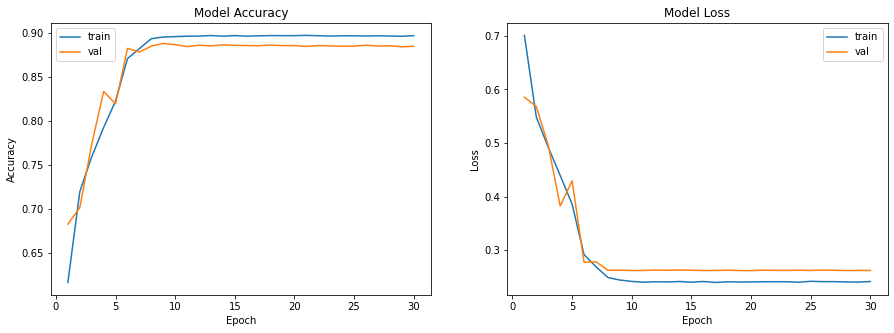

In [23]:
print('train loss:', history.history['loss'][-1])
print('train accuracy:', history.history['accuracy'][-1])

print('dev loss:', history.history['val_loss'][-1])
print('dev accuracy:', history.history['val_accuracy'][-1])

fig, axs = plt.subplots(1,2,figsize=(15,5))

axs[0].plot(range(1,len(history.history['accuracy'])+1), history.history['accuracy'])
axs[0].plot(range(1,len(history.history['val_accuracy'])+1),history.history['val_accuracy'])
axs[0].set_title('Model Accuracy')
axs[0].set_ylabel('Accuracy')
axs[0].set_xlabel('Epoch')
axs[0].legend(['train', 'val'], loc='best')

axs[1].plot(range(1,len(history.history['loss'])+1),history.history['loss'])
axs[1].plot(range(1,len(history.history['val_loss'])+1),history.history['val_loss'])
axs[1].set_title('Model Loss')
axs[1].set_ylabel('Loss')
axs[1].set_xlabel('Epoch')
axs[1].legend(['train', 'val'], loc='best')

plt.show()

In [24]:
predictions = model.predict(x_test)

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Ide

Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:

Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_361836 in device /job:

In [25]:
print(predictions)

y_pred = []

for i in predictions:
    if i[0] < i[1]:
        y_pred.append(1)
    else:
        y_pred.append(0)

[[9.9889946e-01 1.1005098e-03 3.0263594e-11 ... 3.1617101e-11
  3.4043213e-11 3.2972663e-11]
 [3.3005407e-01 6.6994500e-01 1.1350823e-09 ... 9.9075981e-10
  1.1226202e-09 9.8391828e-10]
 [9.9995041e-01 4.9558945e-05 3.7392637e-13 ... 4.1343643e-13
  4.6804720e-13 3.9958442e-13]
 ...
 [2.8107533e-02 9.7189021e-01 2.4146154e-09 ... 2.3015210e-09
  2.5000599e-09 2.5479598e-09]
 [6.6926360e-01 3.3056781e-01 1.5730902e-07 ... 1.6871516e-07
  1.6619629e-07 1.6151613e-07]
 [6.2801272e-01 3.7198520e-01 2.0331263e-09 ... 2.0278015e-09
  2.3233167e-09 1.9762574e-09]]


In [26]:
pred = np.array(predictions)

print(pred.shape)

(5000, 1000)


In [27]:
from sklearn.metrics import confusion_matrix

confusion_mtx = confusion_matrix(y_test, y_pred)

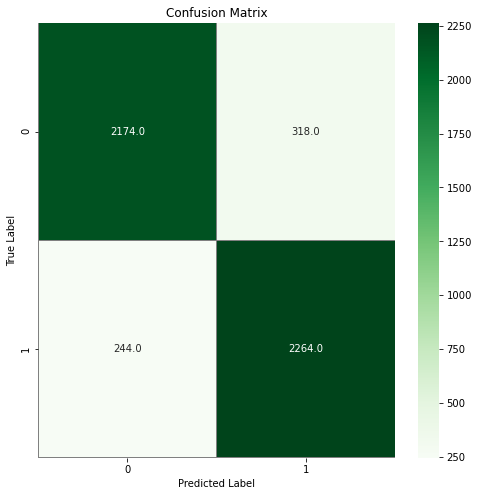

In [28]:
import seaborn as sns

f, ax = plt.subplots(figsize=(8, 8))
sns.heatmap(confusion_mtx, annot=True, linewidths=0.01, cmap="Greens",linecolor="gray", fmt='.1f', ax=ax)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

In [29]:
from sklearn.metrics import classification_report

# Generate a classification report
report = classification_report(y_test, y_pred, target_names=['cat', 'dog'])

In [30]:
print(report)

              precision    recall  f1-score   support

         cat       0.90      0.87      0.89      2492
         dog       0.88      0.90      0.89      2508

    accuracy                           0.89      5000
   macro avg       0.89      0.89      0.89      5000
weighted avg       0.89      0.89      0.89      5000



In [31]:
model.save('resnet50.h5')

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:loc

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:loc

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:loc

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:loc

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:loc

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j